<a href="https://colab.research.google.com/github/jzhu32/Tissue_Segmentation/blob/main/SegPath/Train_Segmentation_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Bladder Cell Type Segmentation - Deep Learning Pipeline

This notebook covers a complete deep learning pipeline for binary segmentation of bladder cell types using H&E images.  
It includes:
- Data loading and augmentation
- Model definition and training
- Loss function customization
- Ensemble model building
- Evaluation and visualization

We use **PyTorch Lightning** for model training and **Segmentation Models PyTorch (SMP)** for architecture.

Dataset: **SegPath Bladder Cell Dataset**  
Cell types: **epithelial, smooth muscle, lymphocyte, myeloid**

<div align="left">
  <a href="https://colab.research.google.com/drive/1iczYDh8oOn3sK-tsCAO-qSerK7USWCBk?usp=sharing" target="_blank">
    <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
  </a>
</div>

# 1. Install Required Packages

In [ ]:
# Install necessary packages
!pip install torch torchvision numpy pandas matplotlib albumentations tqdm segmentation-models-pytorch pytorch-lightning
!pip install pytorch-toolbelt

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 120.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 90.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 40.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

# 2. Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 3. Import Python Libraries

In [ ]:
import os
import copy
import random
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tqdm import tqdm
import pandas as pd
import time

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

import albumentations as A
from albumentations.pytorch import ToTensorV2

import segmentation_models_pytorch as smp

import pytorch_lightning as pl
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import EarlyStopping, ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger
from torch.utils.data import Dataset, DataLoader


# 4. Set Random Seed and Training Device

In [ ]:
# -------------------------------
# Set seed and device
# -------------------------------
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using {device} for training")



Using cuda for training


# 5. Define Dataset and Checkpoint Directories


In [ ]:
# Directories for data and checkpoints
DATADIR = '/content/drive/MyDrive/Bladder_Segpath_Data/sampled_filtered_rigorous'
CKPT_DIR = '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints'
if not os.path.exists(CKPT_DIR):
    os.makedirs(CKPT_DIR)

# 6. Define Custom Loss Functions

In [ ]:
# -------------------------------
# Loss Functions
# -------------------------------
class LogCoshDiceLoss(nn.Module):
    def __init__(self, smooth=1.0, eps=1e-7):
        super().__init__()
        self.smooth = smooth
        self.eps = eps

    def forward(self, y_pred, y_true):
        # Handle input dimensions
        if y_pred.dim() == 4 and y_pred.size(1) == 1 and y_true.dim() == 3:
            # If y_pred is [B,1,H,W] and y_true is [B,H,W]
            y_true = y_true.unsqueeze(1)

        # Apply sigmoid to logits
        y_pred = torch.sigmoid(y_pred)

        # Calculate Dice score for each sample in batch and then average
        batch_size = y_pred.size(0)
        dice_scores = []

        for i in range(batch_size):
            # Get batch item and flatten
            pred_i = y_pred[i].view(-1)
            true_i = y_true[i].float().view(-1)

            # Calculate intersection and union
            intersection = (pred_i * true_i).sum()
            dice_score = (2. * intersection + self.smooth) / (
                pred_i.sum() + true_i.sum() + self.smooth + self.eps
            )
            dice_scores.append(dice_score)

        # Average Dice over batch
        avg_dice = torch.stack(dice_scores).mean()

        # Apply log-cosh to (1 - dice_score)
        loss = torch.log(torch.cosh(1.0 - avg_dice))

        return loss

class FocalTverskyLoss(nn.Module):
    def __init__(self, smooth=1, alpha=0.5, beta=0.5, gamma=1.5):
        super().__init__()
        self.smooth = smooth
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        # Handle input dimensions
        if inputs.dim() > 2:
            inputs = inputs.view(inputs.size(0), inputs.size(1), -1)
            targets = targets.view(targets.size(0), targets.size(1), -1)

        inputs = torch.sigmoid(inputs) # Apply sigmoid to logits

        # Calculate Tversky for each sample in batch and then average
        batch_tversky = []

        for i in range(inputs.size(0)):
            # Get batch item and flatten
            input_i = inputs[i].view(-1)
            target_i = targets[i].float().view(-1)

            # Calculate Tversky index components
            TP = (input_i * target_i).sum()
            FP = ((1 - target_i) * input_i).sum()
            FN = (target_i * (1 - input_i)).sum()

            # Calculate Tversky index
            tversky = (TP + self.smooth) / (TP + self.alpha * FP + self.beta * FN + self.smooth)
            batch_tversky.append(tversky)

        # Average Tversky over batch
        avg_tversky = torch.stack(batch_tversky).mean()

        # Apply focal component
        focal_tversky = (1 - avg_tversky) ** self.gamma

        return focal_tversky

# 7. Define Dataset Class and Filtering Functions

In [ ]:
# -------------------------------
# Dataset Class
# -------------------------------
class SegPathBinaryDataset(Dataset):
    """Dataset for binary segmentation of a specific cell type from SegPath data"""
    def __init__(self, root_dir, cell_type, split='train', transform=None, max_samples=None):
        """
        Args:
            root_dir: Root directory with train/val/test splits
            cell_type: Cell type name ('epithelial', 'smooth_muscle', 'lymphocyte', 'myeloid')
            split: 'train', 'val', or 'test'
            transform: Albumentations transform pipeline
            max_samples: Limit number of samples (for quick experiments)
        """
        self.root_dir = root_dir
        self.cell_type = cell_type
        self.split = split
        self.split_dir = os.path.join(root_dir, split, cell_type)

        if not os.path.exists(self.split_dir):
            raise ValueError(f"Cell type directory not found: {self.split_dir}")

        # Get all HE and mask file pairs
        all_files = os.listdir(self.split_dir)
        mask_files = [f for f in all_files if f.endswith('_mask.png')]
        he_files = [f.replace('_mask.png', '_HE.png') for f in mask_files]

        # Validate file pairs exist
        self.samples = []
        for he_file, mask_file in zip(he_files, mask_files):
            if he_file in all_files:
                he_path = os.path.join(self.split_dir, he_file)
                mask_path = os.path.join(self.split_dir, mask_file)
                self.samples.append((he_path, mask_path))

        print(f"Found {len(self.samples)} samples for {cell_type} in {split} split")

        # Limit samples if requested
        if max_samples is not None and len(self.samples) > max_samples:
            random.seed(seed)
            random.shuffle(self.samples)
            self.samples = self.samples[:max_samples]
            print(f"Limited to {len(self.samples)} samples")

        # Set transform pipeline
        self.transform = transform if transform is not None else self._get_default_transform(split)

    def _get_default_transform(self, phase):
        """Create default transform pipeline based on training phase"""
        if phase == 'train':
            return A.Compose([
                A.RandomCrop(height=640, width=640, p=1.0),
                A.HorizontalFlip(p=0.8),
                A.VerticalFlip(p=0.8),
                A.OneOf([
                    A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=0.9),
                    A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1, p=0.9),
                ], p=0.9),
                A.Affine(scale=(0.9, 1.1), rotate=(-180, 180), p=0.8),
                A.GaussianBlur(blur_limit=3, p=0.3),
                A.Normalize(mean=[124.0/255, 116.0/255, 104.0/255],
                            std=[58.6/255, 57.3/255, 57.6/255]),
                ToTensorV2(),
            ])
        else:
            return A.Compose([
                A.CenterCrop(height=640, width=640),
                A.Normalize(mean=[124.0/255, 116.0/255, 104.0/255],
                            std=[58.6/255, 57.3/255, 57.6/255]),
                ToTensorV2(),
            ])

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        """Get a sample by index, with retry mechanism for corrupt files"""
        max_retries = 5
        curr_idx = idx

        for attempt in range(max_retries):
            try:
                img_path, mask_path = self.samples[curr_idx]

                # Read image
                image = cv2.imread(img_path)
                if image is None:
                    print(f"Warning: Failed to load image {img_path}")
                    curr_idx = (curr_idx + 1) % len(self.samples)
                    continue
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Read mask
                mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
                if mask is None:
                    print(f"Warning: Failed to load mask {mask_path}")
                    curr_idx = (curr_idx + 1) % len(self.samples)
                    continue

                # Convert mask to binary
                binary_mask = (mask > 0).astype(np.uint8)

                # Apply transforms
                transformed = self.transform(image=image, mask=binary_mask)

                # Return without adding extra channel dimension to mask
                return {
                    'image': transformed['image'],
                    'mask': transformed['mask'].float(),
                    'path': img_path,
                    'mask_path': mask_path
                }

            except Exception as e:
                print(f"Error in __getitem__ for {curr_idx}: {str(e)}")
                curr_idx = (curr_idx + 1) % len(self.samples)

        # If all retries fail, return a dummy sample
        print(f"WARNING: Failed to load any valid sample after {max_retries} attempts")
        dummy_image = torch.zeros(3, 640, 640)
        dummy_mask = torch.zeros(640, 640)
        return {
            'image': dummy_image,
            'mask': dummy_mask,
            'path': 'dummy_path',
            'mask_path': 'dummy_mask_path'
        }

def filter_empty_masks(dataset, threshold=0.1):
    """Filter out samples with almost empty masks (less than threshold% foreground)"""
    filtered_samples = []
    empty_count = 0
    total_count = 0

    print("Screening dataset for empty masks...")
    for sample in tqdm(dataset.samples, total=len(dataset.samples)):
        mask_path = sample[1]
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        if mask is None:
            empty_count += 1
            total_count += 1
            continue

        total_pixels = mask.size
        non_zero_pixels = np.count_nonzero(mask)
        mask_percentage = (non_zero_pixels / total_pixels) * 100

        if mask_percentage < threshold:
            empty_count += 1
        else:
            filtered_samples.append(sample)

        total_count += 1

    # Avoid division by zero if no samples are present
    if total_count == 0:
        print("No samples found in dataset.")
    else:
        print(f"Filtered out {empty_count} empty masks out of {total_count} samples ({empty_count/total_count*100:.2f}%).")
        print(f"Remaining samples: {len(filtered_samples)}")

    # Create a new dataset instance with the filtered samples
    filtered_dataset = copy.deepcopy(dataset)
    filtered_dataset.samples = filtered_samples

    return filtered_dataset

# 8. Create Model Function

In [ ]:
# -------------------------------
# Model Creation
# -------------------------------
def create_model(architecture='deeplabv3plus', encoder='efficientnet-b4'):
    model = None

    if architecture == 'deeplabv3plus':
        model = smp.DeepLabV3Plus(
            encoder_name=encoder,
            encoder_weights='imagenet',
            in_channels=3,
            classes=1,
            activation=None
        )
    elif architecture == 'unetplusplus':
        model = smp.UnetPlusPlus(
            encoder_name=encoder,
            encoder_weights='imagenet',
            in_channels=3,
            classes=1,
            activation=None
        )
    elif architecture == 'unet':
        model = smp.Unet(
            encoder_name=encoder,
            encoder_weights='imagenet',
            in_channels=3,
            classes=1,
            activation=None
        )
    else:
        raise ValueError(f"Unsupported architecture: {architecture}")

    return model


# 9. Define PyTorch Lightning Model

In [ ]:
# -------------------------------
# Lightning Module for Binary Segmentation
# -------------------------------
class BinarySegmentationModel(pl.LightningModule):
    def __init__(self,
                 architecture='deeplabv3plus',
                 encoder='efficientnet-b4',
                 lr=1e-3,
                 loss_type="ftv",  # Options: "combo", "dice", "bce", "logcosh", "ftv"
                 loss_params=None,
                 class_name=''):
        super().__init__()
        self.architecture = architecture
        self.encoder = encoder
        self.model = create_model(architecture, encoder)
        self.lr = lr
        self.loss_type = loss_type
        self.class_name = class_name

        # Set default loss parameters if none provided
        if loss_params is None:
            if loss_type == "combo":
                loss_params = {'dice_weight': 0.7, 'bce_weight': 0.3}
            elif loss_type == "ftv":
                loss_params = {'alpha': 0.5, 'beta': 0.5, 'gamma': 1.5}
        self.loss_params = loss_params

        # Initialize loss functions
        self.dice_loss = nn.BCEWithLogitsLoss()  # Simple alternative to DiceLoss
        self.bce_loss = nn.BCEWithLogitsLoss()
        self.logcosh_loss = LogCoshDiceLoss()
        self.ftv_loss = FocalTverskyLoss(**self.loss_params) if loss_type == "ftv" else None

        self.save_hyperparameters()

    def forward(self, x):
        return self.model(x)

    def calculate_dice_score(self, pred, target):
        """Calculate Dice score between prediction and target"""
        smooth = 1.0
        pred_flat = pred.view(-1)
        target_flat = target.view(-1).float()
        intersection = (pred_flat * target_flat).sum()
        return (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)

    def calculate_loss(self, outputs, masks):
        """Calculate loss based on selected loss type"""
        # Convert outputs and masks to the right shape for losses
        if outputs.dim() == 4 and outputs.size(1) == 1:  # Shape: [B, 1, H, W]
            outputs_flat = outputs.squeeze(1)  # Shape: [B, H, W]
        else:
            outputs_flat = outputs

        if self.loss_type == "combo":
            dice_weight = self.loss_params.get('dice_weight', 0.7)
            bce_weight = self.loss_params.get('bce_weight', 0.3)

            if outputs.dim() == 4 and outputs.size(1) == 1 and masks.dim() == 3:
                masks_for_loss = masks.unsqueeze(1).float()
                dice_loss_val = self.dice_loss(outputs, masks_for_loss)
                bce_loss_val = self.bce_loss(outputs, masks_for_loss)
            else:
                dice_loss_val = self.dice_loss(outputs, masks.float())
                bce_loss_val = self.bce_loss(outputs, masks.float())

            loss = dice_weight * dice_loss_val + bce_weight * bce_loss_val

        elif self.loss_type == "dice":
            if outputs.dim() == 4 and outputs.size(1) == 1 and masks.dim() == 3:
                masks_for_loss = masks.unsqueeze(1).float()
                loss = self.dice_loss(outputs, masks_for_loss)
            else:
                loss = self.dice_loss(outputs, masks.float())

        elif self.loss_type == "bce":
            if outputs.dim() == 4 and outputs.size(1) == 1 and masks.dim() == 3:
                masks_for_loss = masks.unsqueeze(1).float()
                loss = self.bce_loss(outputs, masks_for_loss)
            else:
                loss = self.bce_loss(outputs, masks.float())

        elif self.loss_type == "logcosh":
            loss = self.logcosh_loss(outputs, masks)

        elif self.loss_type == "ftv":
            loss = self.ftv_loss(outputs, masks)

        else:
            raise ValueError(f"Unknown loss type: {self.loss_type}")

        # Calculate Dice score for monitoring
        with torch.no_grad():
            if outputs.dim() == 4 and outputs.size(1) == 1:
                pred = (torch.sigmoid(outputs.squeeze(1)) > 0.5).float()
            else:
                pred = (torch.sigmoid(outputs) > 0.5).float()

            dice_score = self.calculate_dice_score(pred, masks.float())

        return loss, dice_score

    def training_step(self, batch, batch_idx):
        images = batch['image']
        masks = batch['mask']

        # Forward pass
        outputs = self.forward(images)

        # Calculate loss
        loss, dice_score = self.calculate_loss(outputs, masks)

        # Log metrics
        self.log('train_loss', loss, prog_bar=True, on_epoch=True)
        self.log('train_dice', dice_score, prog_bar=True, on_epoch=True)

        return loss

    def validation_step(self, batch, batch_idx):
        images = batch['image']
        masks = batch['mask']

        # Forward pass
        outputs = self.forward(images)

        # Calculate loss
        loss, dice_score = self.calculate_loss(outputs, masks)

        # Log metrics
        self.log('val_loss', loss, prog_bar=True)
        self.log('val_dice', dice_score, prog_bar=True)

        return {'val_loss': loss, 'val_dice': dice_score}

    def test_step(self, batch, batch_idx):
        images = batch['image']
        masks = batch['mask']

        # Forward pass
        outputs = self.forward(images)

        # Calculate loss and metrics
        loss, dice_score = self.calculate_loss(outputs, masks)

        # Calculate additional metrics
        pred_masks = (torch.sigmoid(outputs) > 0.5).float()

        # Calculate true positives, false positives, false negatives
        tp = ((pred_masks == 1) & (masks == 1)).sum().float()
        fp = ((pred_masks == 1) & (masks == 0)).sum().float()
        fn = ((pred_masks == 0) & (masks == 1)).sum().float()
        tn = ((pred_masks == 0) & (masks == 0)).sum().float()

        # Calculate precision, recall, and F1
        precision = tp / (tp + fp + 1e-7)
        recall = tp / (tp + fn + 1e-7)
        f1 = 2 * precision * recall / (precision + recall + 1e-7)

        # Log metrics
        self.log('test_loss', loss)
        self.log('test_dice', dice_score)
        self.log('test_precision', precision)
        self.log('test_recall', recall)
        self.log('test_f1', f1)

        return {
            'test_loss': loss,
            'test_dice': dice_score,
            'test_precision': precision,
            'test_recall': recall,
            'test_f1': f1
        }

    def configure_optimizers(self):
        """Configure optimizer and learning rate scheduler"""
        optimizer = optim.Adam(
            self.parameters(),
            lr=self.lr,
            weight_decay=1e-4
        )

        scheduler = optim.lr_scheduler.CosineAnnealingLR(
            optimizer,
            T_max=10,
            eta_min=self.lr/100
        )

        return {
            'optimizer': optimizer,
            'lr_scheduler': scheduler,
            'monitor': 'val_loss'
        }


# 10. Define Ensemble Model

In [ ]:
# -------------------------------
# Ensemble Model
# -------------------------------
class EnsembleModel(nn.Module):
    """Ensemble of multiple binary segmentation models"""
    def __init__(self, models):
        super().__init__()
        self.models = nn.ModuleList(models)

    def forward(self, x):
        """Forward pass through all models and average their predictions"""
        outputs = []
        for model in self.models:
            outputs.append(model(x))
        return torch.stack(outputs).mean(dim=0)

    def predict(self, x):
        """Predict binary mask (0 or 1) from input image"""
        with torch.no_grad():
            logits = self.forward(x)
            return (torch.sigmoid(logits) > 0.5).float()


# 11. Define Metrics Tracking Callback

In [ ]:
# -------------------------------
# Metrics Tracking Callback
# -------------------------------
class MetricsCallback(pl.Callback):
    def __init__(self):
        super().__init__()
        self.metrics = {
            "epoch": [],
            "train_loss": [],
            "val_loss": [],
            "val_dice": [],
            "lr": []
        }

    def on_validation_epoch_end(self, trainer, pl_module):
        epoch = trainer.current_epoch
        metrics = trainer.callback_metrics

        train_loss = metrics.get("train_loss")
        val_loss = metrics.get("val_loss")
        val_dice = metrics.get("val_dice")

        lr = trainer.optimizers[0].param_groups[0]["lr"] if trainer.optimizers else None

        self.metrics["epoch"].append(epoch)
        self.metrics["train_loss"].append(train_loss.cpu().item() if train_loss is not None else None)
        self.metrics["val_loss"].append(val_loss.cpu().item() if val_loss is not None else None)
        self.metrics["val_dice"].append(val_dice.cpu().item() if val_dice is not None else None)
        self.metrics["lr"].append(lr)


# 12. Define Training and Ensemble Training Functions

In [ ]:
# -------------------------------
# Training Functions
# -------------------------------
def train_model(model_config, cell_type, data_dir, n_epochs=25):
    """Train a single model with specified configuration"""
    print(f"\nTraining model for {cell_type} with configuration:")
    for k, v in model_config.items():
        print(f"  {k}: {v}")

    # Extract parameters
    architecture = model_config['architecture']
    encoder = model_config['encoder']
    loss_type = model_config['loss_type']
    lr = model_config['learning_rate']
    batch_size = model_config['batch_size']

    # Loss-specific parameters
    loss_params = {}
    if loss_type == 'combo':
        loss_params['dice_weight'] = model_config.get('dice_weight', 0.7)
        loss_params['bce_weight'] = 1.0 - loss_params['dice_weight']
    elif loss_type == 'ftv':
        loss_params['alpha'] = model_config.get('ftv_alpha', 0.5)
        loss_params['beta'] = model_config.get('ftv_beta', 0.5)
        loss_params['gamma'] = model_config.get('ftv_gamma', 1.5)

    # Prepare datasets and dataloaders
    print(f"Loading datasets for {cell_type}...")
    train_dataset = SegPathBinaryDataset(root_dir=data_dir, cell_type=cell_type, split='train')
    val_dataset = SegPathBinaryDataset(root_dir=data_dir, cell_type=cell_type, split='val')
    test_dataset = SegPathBinaryDataset(root_dir=data_dir, cell_type=cell_type, split='test')

    # Filter empty masks
    train_dataset = filter_empty_masks(train_dataset)
    val_dataset = filter_empty_masks(val_dataset)
    test_dataset = filter_empty_masks(test_dataset, threshold=0.05)  # Lower threshold for test set

    # Create data loaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory=True
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,
        pin_memory=True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,
        pin_memory=True
    )

    # Create model directory
    os.makedirs(os.path.join(CKPT_DIR, cell_type), exist_ok=True)

    # Create model
    model = BinarySegmentationModel(
        architecture=architecture,
        encoder=encoder,
        lr=lr,
        loss_type=loss_type,
        loss_params=loss_params,
        class_name=cell_type
    )

    # Callbacks
    metrics_callback = MetricsCallback()
    early_stop = EarlyStopping(
        monitor='val_dice',
        patience=5,
        mode='max',
        verbose=True
    )

    checkpoint = ModelCheckpoint(
        dirpath=os.path.join(CKPT_DIR, cell_type),
        filename=f'best-{cell_type}-{architecture}-{encoder}',
        monitor='val_dice',
        mode='max',
        save_top_k=1,
        verbose=True
    )

    # Logger
    logger = TensorBoardLogger(
        save_dir=os.path.join(CKPT_DIR, cell_type),
        name=f'model_{architecture}_{encoder}'
    )

    # Create trainer
    trainer = Trainer(
        max_epochs=n_epochs,
        accelerator='gpu' if torch.cuda.is_available() else 'cpu',
        devices=1,
        logger=logger,
        callbacks=[early_stop, checkpoint, metrics_callback],
        log_every_n_steps=10,
        precision='16-mixed'  # Use mixed precision for faster training
    )

    # Train model
    trainer.fit(model, train_loader, val_loader)

    # Test model
    results = trainer.test(model, test_loader)

    if results:
        results = results[0]
        print(f"\nTest results for {cell_type}:")
        for k, v in results.items():
            print(f"  {k}: {v:.4f}")
    else:
        results = {}
        print(f"No test results for {cell_type}")

    # Plot training metrics
    epochs = metrics_callback.metrics["epoch"]
    train_loss = metrics_callback.metrics["train_loss"]
    val_loss = metrics_callback.metrics["val_loss"]
    val_dice = metrics_callback.metrics["val_dice"]

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_loss, 'b-', label='Train Loss')
    plt.plot(epochs, val_loss, 'r-', label='Val Loss')
    plt.title(f'{cell_type} - Training/Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, val_dice, 'g-', label='Val Dice')
    plt.title(f'{cell_type} - Validation Dice')
    plt.xlabel('Epoch')
    plt.ylabel('Dice')
    plt.legend()

    plt.tight_layout()
    plt.show()

    # Return model path, results, and metrics
    return checkpoint.best_model_path, results, metrics_callback.metrics

def train_ensemble(cell_type, data_dir, config_list, n_epochs=25):
    """Train an ensemble of models for a cell type"""
    print(f"\nTraining ensemble for {cell_type}...")

    models = []
    results = []

    # Train multiple models with different configurations
    for i, config in enumerate(config_list):
        print(f"\nTraining model {i+1}/{len(config_list)} for {cell_type}")
        model_path, model_results, metrics = train_model(config, cell_type, data_dir, n_epochs)

        # Load the best checkpoint
        model = BinarySegmentationModel.load_from_checkpoint(model_path)
        models.append(model)
        results.append(model_results)

    # Create ensemble
    ensemble = EnsembleModel(models)

    # Save the ensemble model
    ensemble_path = os.path.join(CKPT_DIR, cell_type, f'ensemble_{cell_type}.pt')
    torch.save(ensemble.state_dict(), ensemble_path)

    print(f"\nEnsemble model for {cell_type} saved to {ensemble_path}")

    # Return the ensemble and results
    return ensemble, results


# 13. Define Visualization Functions

In [ ]:
# -------------------------------
# Visualization Functions
# -------------------------------
def visualize_batch(dataloader, title="Sample Batch"):
    """Visualize a batch of images and masks"""
    batch = next(iter(dataloader))
    images = batch['image'].cpu().numpy()
    masks = batch['mask'].cpu().numpy()

    # Get number of samples to display
    n_samples = min(4, images.shape[0])

    fig, axes = plt.subplots(n_samples, 2, figsize=(10, 3 * n_samples))
    if n_samples == 1:
        axes = axes.reshape(1, 2)

    # Display each sample
    for i in range(n_samples):
        # Process image (denormalize)
        img = images[i].transpose(1, 2, 0)
        mean = np.array([124.0/255, 116.0/255, 104.0/255])
        std = np.array([58.6/255, 57.3/255, 57.6/255])
        img = std * img + mean
        img = np.clip(img, 0, 1)

        # Display image
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"H&E Image {i+1}")
        axes[i, 0].axis('off')

        # Display mask
        axes[i, 1].imshow(masks[i], cmap='gray')
        axes[i, 1].set_title(f"Binary Mask {i+1}")
        axes[i, 1].axis('off')

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

    return fig

def visualize_predictions(model, test_loader, cell_type, num_samples=4):
    """Visualize predictions from a model on test data"""
    model.eval()

    # Get batch of images
    batch = next(iter(test_loader))
    images = batch['image'].to(device)
    masks = batch['mask'].cpu().numpy()

    # Get predictions
    with torch.no_grad():
        logits = model(images)
        if isinstance(model, EnsembleModel):
            preds = model.predict(images).cpu().numpy()
        else:
            preds = (torch.sigmoid(logits) > 0.5).float().cpu().numpy()

    # Get images for visualization
    images = images.cpu().numpy()

    # Create figure
    n_samples = min(num_samples, images.shape[0])
    fig, axes = plt.subplots(n_samples, 3, figsize=(15, 5 * n_samples))

    if n_samples == 1:
        axes = axes.reshape(1, 3)

    for i in range(n_samples):
        # Display original image
        img = images[i].transpose(1, 2, 0)
        mean = np.array([124.0/255, 116.0/255, 104.0/255])
        std = np.array([58.6/255, 57.3/255, 57.6/255])
        img = std * img + mean
        img = np.clip(img, 0, 1)

        axes[i, 0].imshow(img)
        axes[i, 0].set_title("H&E Image")
        axes[i, 0].axis('off')

        # Display ground truth mask
        # Ensure mask is 2D for visualization
        mask_vis = masks[i]
        if mask_vis.ndim == 3:  # If mask has channel dimension
            mask_vis = mask_vis.squeeze()

        axes[i, 1].imshow(mask_vis, cmap='gray')
        axes[i, 1].set_title("Ground Truth")
        axes[i, 1].axis('off')

        # Display predicted mask
        # Ensure prediction is 2D for visualization
        pred_vis = preds[i]
        if pred_vis.ndim == 3:  # If prediction has channel dimension
            pred_vis = pred_vis.squeeze()

        axes[i, 2].imshow(pred_vis, cmap='gray')
        axes[i, 2].set_title("Prediction")
        axes[i, 2].axis('off')

    plt.suptitle(f"Predictions for {cell_type}", fontsize=16)
    plt.tight_layout()
    plt.show()

    return fig

def visualize_performance_metrics(results_dict, title="Model Performance Metrics"):
    """Visualize performance metrics across cell types"""
    # Extract metrics
    cell_types = list(results_dict.keys())
    dice_scores = [results_dict[ct]['test_dice'] for ct in cell_types]
    precision_scores = [results_dict[ct]['test_precision'] for ct in cell_types]
    recall_scores = [results_dict[ct]['test_recall'] for ct in cell_types]
    f1_scores = [results_dict[ct]['test_f1'] for ct in cell_types]

    # Create figure
    fig, ax = plt.subplots(figsize=(12, 6))

    # Set width of bars
    bar_width = 0.2
    index = np.arange(len(cell_types))

    # Create bars
    bar1 = ax.bar(index, dice_scores, bar_width, label='Dice')
    bar2 = ax.bar(index + bar_width, precision_scores, bar_width, label='Precision')
    bar3 = ax.bar(index + 2*bar_width, recall_scores, bar_width, label='Recall')
    bar4 = ax.bar(index + 3*bar_width, f1_scores, bar_width, label='F1')

    # Add labels and titles
    ax.set_xlabel('Cell Type')
    ax.set_ylabel('Score')
    ax.set_title(title)
    ax.set_xticks(index + 1.5*bar_width)
    ax.set_xticklabels(cell_types)
    ax.legend()

    # Add value labels
    def add_labels(bars):
        for bar in bars:
            height = bar.get_height()
            ax.annotate(f'{height:.3f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 3),
                        textcoords="offset points",
                        ha='center', va='bottom', rotation=90)

    add_labels(bar1)
    add_labels(bar2)
    add_labels(bar3)
    add_labels(bar4)

    plt.ylim(0, 1.0)
    plt.tight_layout()
    plt.show()

    return fig

def generate_combined_segmentation(ensembles, image, cell_types):
    """Generate a combined segmentation for multiple cell types"""
    # Create a multi-channel segmentation mask (0=background)
    segmentation = np.zeros((image.shape[2], image.shape[3], len(cell_types) + 1), dtype=np.float32)

    # Process each cell type
    for i, cell_type in enumerate(cell_types):
        ensemble = ensembles[cell_type]

        # Get prediction
        with torch.no_grad():
            pred = ensemble.predict(image)
            # Ensure prediction has the right shape for visualization
            if pred.ndim == 4:  # (batch, channel, height, width)
                pred = pred[:, 0]  # Take first channel
            pred = pred[0].cpu().numpy()  # Take first sample

        # Add to segmentation (channel i+1 for cell type i)
        segmentation[:, :, i+1] = pred

    # Background is where no cell type is detected
    segmentation[:, :, 0] = 1.0 - np.max(segmentation[:, :, 1:], axis=2)

    return segmentation

def display_combined_segmentation(image, segmentation, cell_types):
    """Display the combined segmentation as a color-coded image"""
    # Define colors for each cell type and background
    colors = [
        [0, 0, 0],  #Background: black
        [1, 0, 0],  #cell type 1: red (epithelial)
        [0, 1, 0],  #Cell type 2: green (smooth muscle)
        [0, 0, 1],  #cell type 3: blue (lymphocyte)
        [1, 1, 0],  #cell type 4: yellow (myeloid)
    ]

    # Create a color image
    color_segmentation = np.zeros((segmentation.shape[0], segmentation.shape[1], 3), dtype=np.float32)

    # Apply colors based on the class with highest probability
    class_indices = np.argmax(segmentation, axis=2)
    for i in range(min(len(colors), segmentation.shape[2])):
        mask = (class_indices == i)
        for c in range(3):
            color_segmentation[:, :, c][mask] = colors[i][c]

    # Process image for display
    img = image[0].cpu().numpy().transpose(1, 2, 0)
    mean = np.array([124.0/255, 116.0/255, 104.0/255])
    std = np.array([58.6/255, 57.3/255, 57.6/255])
    img = std * img + mean
    img = np.clip(img, 0, 1)

    # Create figure
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display original image
    axes[0].imshow(img)
    axes[0].set_title("H&E Image")
    axes[0].axis('off')

    # Display color segmentation
    axes[1].imshow(color_segmentation)
    axes[1].set_title("Combined Segmentation")
    axes[1].axis('off')

    # Add legend
    legend_elements = [plt.Line2D([0], [0], marker='s', color='w',
                                  markerfacecolor=colors[i], markersize=15,
                                  label=name if i > 0 else 'Background')
                       for i, name in enumerate(['Background'] + cell_types)]

    axes[1].legend(handles=legend_elements, loc='upper right')

    plt.tight_layout()
    plt.show()

    return fig


# 14. Main Training Routine

In [ ]:
# -------------------------------
# Main function
# -------------------------------
def main():
    """Main function to run the SegPath binary segmentation pipeline"""
    cell_types = ['epithelial', 'smooth_muscle', 'lymphocyte', 'myeloid']

    # Each cell type gets 2 models with different configurations
    model_configs = {
        'epithelial': [
            {
                'architecture': 'deeplabv3plus',
                'encoder': 'efficientnet-b4',
                'loss_type': 'ftv',
                'learning_rate': 1e-3,
                'batch_size': 16,
                'ftv_alpha': 0.5,
                'ftv_beta': 0.5,
                'ftv_gamma': 1.5
            },
            {
                'architecture': 'unetplusplus',
                'encoder': 'resnet34',
                'loss_type': 'logcosh',
                'learning_rate': 5e-4,
                'batch_size': 16
            }
        ],
        'smooth_muscle': [
            {
                'architecture': 'deeplabv3plus',
                'encoder': 'efficientnet-b4',
                'loss_type': 'ftv',
                'learning_rate': 1e-3,
                'batch_size': 16,
                'ftv_alpha': 0.5,
                'ftv_beta': 0.5,
                'ftv_gamma': 1.5
            },
            {
                'architecture': 'unet',
                'encoder': 'resnet34',
                'loss_type': 'logcosh',
                'learning_rate': 5e-4,
                'batch_size': 16
            }
        ],
        'lymphocyte': [
            {
                'architecture': 'unetplusplus',
                'encoder': 'efficientnet-b4',
                'loss_type': 'ftv',
                'learning_rate': 1e-3,
                'batch_size': 16,
                'ftv_alpha': 0.5,
                'ftv_beta': 0.5,
                'ftv_gamma': 1.5
            },
            {
                'architecture': 'deeplabv3plus',
                'encoder': 'resnet34',
                'loss_type': 'dice',
                'learning_rate': 5e-4,
                'batch_size': 16
            }
        ],
        'myeloid': [
            {
                'architecture': 'deeplabv3plus',
                'encoder': 'efficientnet-b4',
                'loss_type': 'ftv',
                'learning_rate': 1e-3,
                'batch_size': 16,
                'ftv_alpha': 0.3,
                'ftv_beta': 0.7,
                'ftv_gamma': 2.0
            },
            {
                'architecture': 'unet',
                'encoder': 'resnet34',
                'loss_type': 'logcosh',
                'learning_rate': 7e-4,
                'batch_size': 16
            }
        ]
    }

    # Number of epochs for final model training
    n_epochs = 15

    # Create directories
    for cell_type in cell_types:
        os.makedirs(os.path.join(CKPT_DIR, cell_type), exist_ok=True)

    # Dictionary to store ensembles and results
    ensembles = {}
    results_dict = {}
    test_loaders = {}

    # Step 1: Train model ensembles for each cell type
    for cell_type in cell_types:
        print(f"\n{'='*50}")
        print(f"Training ensemble for {cell_type}")
        print(f"{'='*50}")

        # Train ensemble
        ensemble, ensemble_results = train_ensemble(
            cell_type,
            DATADIR,
            model_configs[cell_type],
            n_epochs=n_epochs
        )

        # Store ensemble and results
        ensembles[cell_type] = ensemble
        results_dict[cell_type] = ensemble_results[0]

        # Create test loader for visualization
        test_dataset = SegPathBinaryDataset(root_dir=DATADIR, cell_type=cell_type, split='test')
        test_dataset = filter_empty_masks(test_dataset, threshold=0.05)  # Lower threshold for test
        test_loaders[cell_type] = DataLoader(
            test_dataset,
            batch_size=4,
            shuffle=False,
            num_workers=2,
            pin_memory=True
        )

    # Step 2: Visualize performance across cell types
    if results_dict:
        print("\nVisualizing performance metrics...")
        visualize_performance_metrics(results_dict, "Ensemble Model Performance")

    # Step 3: Visualize predictions for each cell type
    for cell_type, ensemble in ensembles.items():
        print(f"\nVisualizing predictions for {cell_type}...")
        if cell_type in test_loaders and len(test_loaders[cell_type].dataset) > 0:
            visualize_predictions(ensemble, test_loaders[cell_type], cell_type)
        else:
            print(f"No test data available for {cell_type}")

    # Step 4: Generate combined segmentation if possible
    if ensembles and test_loaders:
        print("\nVisualizing combined segmentation...")
        common_image = None
        for cell_type in cell_types:
            if cell_type in test_loaders and len(test_loaders[cell_type].dataset) > 0:
                for batch in test_loaders[cell_type]:
                    common_image = batch['image'].to(device)
                    break
                if common_image is not None:
                    break

        if common_image is not None:
            print("Generating combined segmentation...")
            active_cell_types = [ct for ct in cell_types if ct in ensembles]
            segmentation = generate_combined_segmentation(
                {ct: ensembles[ct] for ct in active_cell_types},
                common_image,
                active_cell_types
            )
            display_combined_segmentation(common_image, segmentation, active_cell_types)
        else:
            print("No test images available for combined segmentation")

    print("\nSegPath binary segmentation ensemble training complete!")
    return ensembles, results_dict


Starting SegPath binary segmentation training...

Training ensemble for epithelial

Training ensemble for epithelial...

Training model 1/2 for epithelial

Training model for epithelial with configuration:
  architecture: deeplabv3plus
  encoder: efficientnet-b4
  loss_type: ftv
  learning_rate: 0.001
  batch_size: 16
  ftv_alpha: 0.5
  ftv_beta: 0.5
  ftv_gamma: 1.5
Loading datasets for epithelial...
Found 2000 samples for epithelial in train split
Found 200 samples for epithelial in val split
Found 200 samples for epithelial in test split
Screening dataset for empty masks...


100%|██████████| 2000/2000 [00:50<00:00, 39.56it/s] 


Filtered out 0 empty masks out of 2000 samples (0.00%).
Remaining samples: 2000
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 132.43it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 138.85it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | DeepLabV3Plus     | 18.6 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
4 | ftv_loss     | FocalTverskyLoss  | 0      | train
-----------------------------------------------------------
18.6 M    Trainable params
0         Non-trainable params
18.6 M    Total params
74.465    To

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.597
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 125: 'val_dice' reached 0.59693 (best 0.59693), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.020 >= min_delta = 0.0. New best score: 0.617
INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 250: 'val_dice' reached 0.61737 (best 0.61737), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 375: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 500: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.012 >= min_delta = 0.0. New best score: 0.629
INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 625: 'val_dice' reached 0.62909 (best 0.62909), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.016 >= min_delta = 0.0. New best score: 0.645
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 750: 'val_dice' reached 0.64540 (best 0.64540), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 875: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 1000: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.007 >= min_delta = 0.0. New best score: 0.653
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 1125: 'val_dice' reached 0.65284 (best 0.65284), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.006 >= min_delta = 0.0. New best score: 0.659
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 1250: 'val_dice' reached 0.65933 (best 0.65933), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.660
INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 1375: 'val_dice' reached 0.66010 (best 0.66010), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.005 >= min_delta = 0.0. New best score: 0.665
INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 1500: 'val_dice' reached 0.66534 (best 0.66534), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 1625: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 1750: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.003 >= min_delta = 0.0. New best score: 0.669
INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1875: 'val_dice' reached 0.66862 (best 0.66862), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-deeplabv3plus-efficientnet-b4-v3.ckpt' as top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │     0.742340624332428     │
│          test_f1          │    0.4124760329723358     │
│         test_loss         │    0.19722574949264526    │
│      test_precision       │    0.3620522618293762     │
│        test_recall        │    0.4910918176174164     │
└───────────────────────────┴───────────────────────────┘


Test results for epithelial:
  test_loss: 0.1972
  test_dice: 0.7423
  test_precision: 0.3621
  test_recall: 0.4911
  test_f1: 0.4125


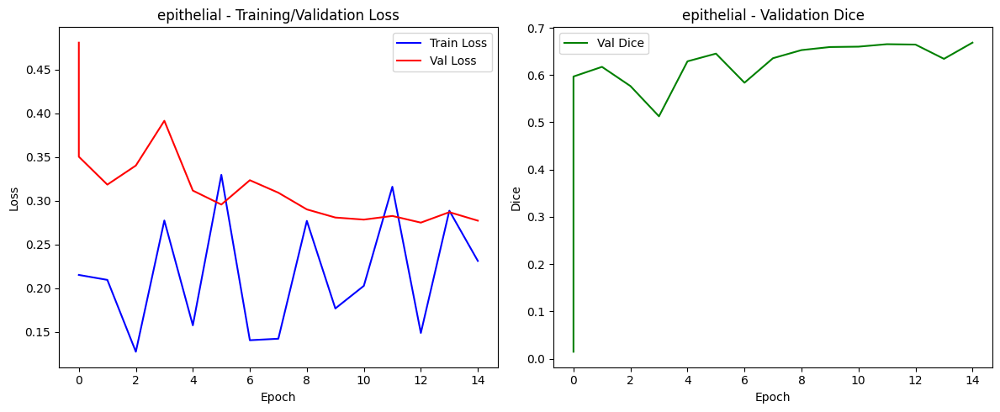


Training model 2/2 for epithelial

Training model for epithelial with configuration:
  architecture: unetplusplus
  encoder: resnet34
  loss_type: logcosh
  learning_rate: 0.0005
  batch_size: 16
Loading datasets for epithelial...
Found 2000 samples for epithelial in train split
Found 200 samples for epithelial in val split
Found 200 samples for epithelial in test split
Screening dataset for empty masks...


100%|██████████| 2000/2000 [00:52<00:00, 38.41it/s] 


Filtered out 0 empty masks out of 2000 samples (0.00%).
Remaining samples: 2000
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 141.94it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 143.47it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | UnetPlusPlus      | 26.1 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
-----------------------------------------------------------
26.1 M    Trainable params
0         Non-trainable params
26.1 M    Total params
104.314   Total estimated model params size (MB)
269       Modules

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.553
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 125: 'val_dice' reached 0.55333 (best 0.55333), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.034 >= min_delta = 0.0. New best score: 0.587
INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 250: 'val_dice' reached 0.58723 (best 0.58723), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 375: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.007 >= min_delta = 0.0. New best score: 0.594
INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 500: 'val_dice' reached 0.59420 (best 0.59420), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.005 >= min_delta = 0.0. New best score: 0.599
INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 625: 'val_dice' reached 0.59880 (best 0.59880), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.021 >= min_delta = 0.0. New best score: 0.620
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 750: 'val_dice' reached 0.62023 (best 0.62023), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.019 >= min_delta = 0.0. New best score: 0.639
INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 875: 'val_dice' reached 0.63895 (best 0.63895), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 1000: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.003 >= min_delta = 0.0. New best score: 0.642
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 1125: 'val_dice' reached 0.64160 (best 0.64160), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.013 >= min_delta = 0.0. New best score: 0.654
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 1250: 'val_dice' reached 0.65417 (best 0.65417), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 1375: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 1500: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.003 >= min_delta = 0.0. New best score: 0.657
INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 1625: 'val_dice' reached 0.65720 (best 0.65720), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/best-epithelial-unetplusplus-resnet34-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 1750: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1875: 'val_dice' was not in top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.7153955101966858     │
│          test_f1          │     0.422378271818161     │
│         test_loss         │    0.07309281080961227    │
│      test_precision       │    0.35907769203186035    │
│        test_recall        │    0.5337604880332947     │
└───────────────────────────┴───────────────────────────┘


Test results for epithelial:
  test_loss: 0.0731
  test_dice: 0.7154
  test_precision: 0.3591
  test_recall: 0.5338
  test_f1: 0.4224


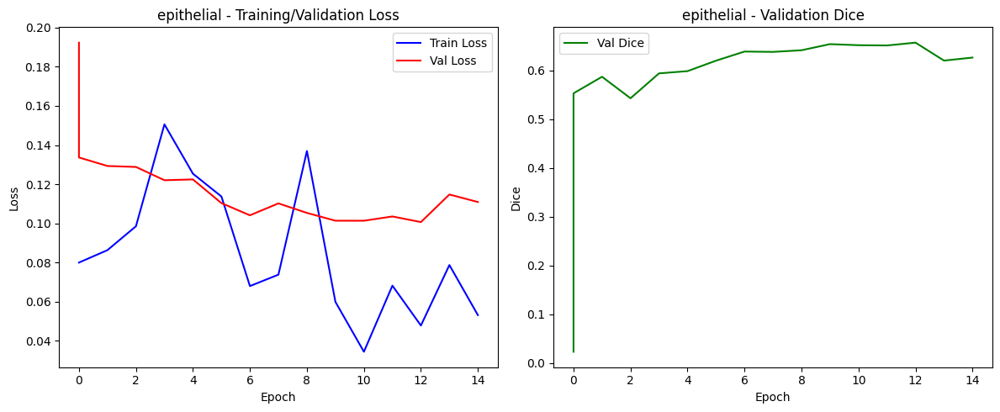


Ensemble model for epithelial saved to /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/epithelial/ensemble_epithelial.pt
Found 200 samples for epithelial in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 74.00it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200

Training ensemble for smooth_muscle

Training ensemble for smooth_muscle...

Training model 1/2 for smooth_muscle

Training model for smooth_muscle with configuration:
  architecture: deeplabv3plus
  encoder: efficientnet-b4
  loss_type: ftv
  learning_rate: 0.001
  batch_size: 16
  ftv_alpha: 0.5
  ftv_beta: 0.5
  ftv_gamma: 1.5
Loading datasets for smooth_muscle...
Found 2000 samples for smooth_muscle in train split
Found 200 samples for smooth_muscle in val split
Found 200 samples for smooth_muscle in test split
Screening dataset for empty masks...


100%|██████████| 2000/2000 [02:04<00:00, 16.09it/s] 


Filtered out 0 empty masks out of 2000 samples (0.00%).
Remaining samples: 2000
Screening dataset for empty masks...


100%|██████████| 200/200 [00:55<00:00,  3.58it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [01:03<00:00,  3.16it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | DeepLabV3Plus     | 18.6 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | trai

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.364
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 125: 'val_dice' reached 0.36389 (best 0.36389), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 250: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.010 >= min_delta = 0.0. New best score: 0.374
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 375: 'val_dice' reached 0.37362 (best 0.37362), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.024 >= min_delta = 0.0. New best score: 0.397
INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 500: 'val_dice' reached 0.39727 (best 0.39727), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 625: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 750: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 875: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.398
INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 1000: 'val_dice' reached 0.39796 (best 0.39796), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.009 >= min_delta = 0.0. New best score: 0.407
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 1125: 'val_dice' reached 0.40707 (best 0.40707), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.018 >= min_delta = 0.0. New best score: 0.425
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 1250: 'val_dice' reached 0.42493 (best 0.42493), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-deeplabv3plus-efficientnet-b4-v6.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 1375: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 1500: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 1625: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 1750: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_dice did not improve in the last 5 records. Best score: 0.425. Signaling Trainer to stop.
INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1875: 'val_dice' was not in top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.4639045000076294     │
│          test_f1          │    0.26568183302879333    │
│         test_loss         │    0.48339614272117615    │
│      test_precision       │    0.2005985677242279     │
│        test_recall        │    0.4482489824295044     │
└───────────────────────────┴───────────────────────────┘


Test results for smooth_muscle:
  test_loss: 0.4834
  test_dice: 0.4639
  test_precision: 0.2006
  test_recall: 0.4482
  test_f1: 0.2657


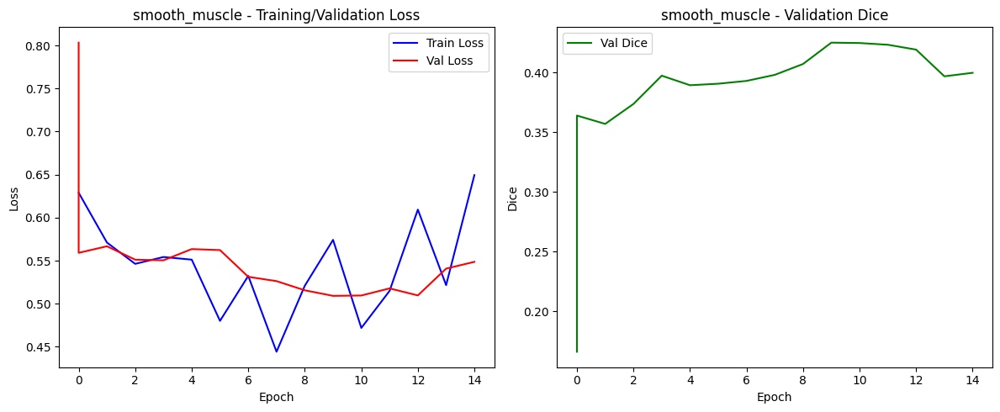


Training model 2/2 for smooth_muscle

Training model for smooth_muscle with configuration:
  architecture: unet
  encoder: resnet34
  loss_type: logcosh
  learning_rate: 0.0005
  batch_size: 16
Loading datasets for smooth_muscle...
Found 2000 samples for smooth_muscle in train split
Found 200 samples for smooth_muscle in val split
Found 200 samples for smooth_muscle in test split
Screening dataset for empty masks...


100%|██████████| 2000/2000 [00:51<00:00, 39.06it/s] 


Filtered out 0 empty masks out of 2000 samples (0.00%).
Remaining samples: 2000
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 137.73it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 140.15it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | Unet              | 24.4 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
-----------------------------------------------------------
24.4 M    Trainable params
0         Non-trainable params
24.4 M    Total params
97.745    Total estimated model params size (MB)
191       Modules

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.350
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 125: 'val_dice' reached 0.35024 (best 0.35024), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.014 >= min_delta = 0.0. New best score: 0.364
INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 250: 'val_dice' reached 0.36434 (best 0.36434), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.005 >= min_delta = 0.0. New best score: 0.369
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 375: 'val_dice' reached 0.36933 (best 0.36933), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 500: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 625: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.000 >= min_delta = 0.0. New best score: 0.370
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 750: 'val_dice' reached 0.36967 (best 0.36967), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.013 >= min_delta = 0.0. New best score: 0.383
INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 875: 'val_dice' reached 0.38263 (best 0.38263), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 1000: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.383
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 1125: 'val_dice' reached 0.38334 (best 0.38334), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.003 >= min_delta = 0.0. New best score: 0.386
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 1250: 'val_dice' reached 0.38635 (best 0.38635), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.387
INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 1375: 'val_dice' reached 0.38720 (best 0.38720), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 1500: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.388
INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 1625: 'val_dice' reached 0.38833 (best 0.38833), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 1750: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.391
INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1875: 'val_dice' reached 0.39054 (best 0.39054), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/best-smooth_muscle-unet-resnet34-v5.ckpt' as top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.43584227561950684    │
│          test_f1          │    0.27738404273986816    │
│         test_loss         │    0.19001932442188263    │
│      test_precision       │    0.19994011521339417    │
│        test_recall        │    0.5111019015312195     │
└───────────────────────────┴───────────────────────────┘


Test results for smooth_muscle:
  test_loss: 0.1900
  test_dice: 0.4358
  test_precision: 0.1999
  test_recall: 0.5111
  test_f1: 0.2774


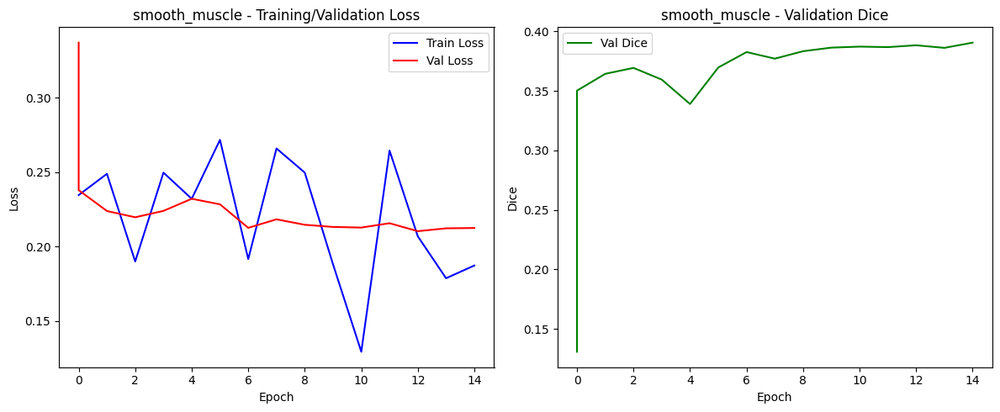


Ensemble model for smooth_muscle saved to /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/smooth_muscle/ensemble_smooth_muscle.pt
Found 200 samples for smooth_muscle in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 71.01it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200

Training ensemble for lymphocyte

Training ensemble for lymphocyte...

Training model 1/2 for lymphocyte

Training model for lymphocyte with configuration:
  architecture: unetplusplus
  encoder: efficientnet-b4
  loss_type: ftv
  learning_rate: 0.001
  batch_size: 16
  ftv_alpha: 0.5
  ftv_beta: 0.5
  ftv_gamma: 1.5
Loading datasets for lymphocyte...
Found 1177 samples for lymphocyte in train split
Found 200 samples for lymphocyte in val split
Found 200 samples for lymphocyte in test split
Screening dataset for empty masks...


100%|██████████| 1177/1177 [02:59<00:00,  6.56it/s] 


Filtered out 0 empty masks out of 1177 samples (0.00%).
Remaining samples: 1177
Screening dataset for empty masks...


100%|██████████| 200/200 [00:55<00:00,  3.62it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [01:11<00:00,  2.80it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | UnetPlusPlus      | 20.8 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
4

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/pytorch_lightning/utilities/data.py:79: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 9. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.431
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 74: 'val_dice' reached 0.43147 (best 0.43147), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 148: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.433
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 222: 'val_dice' reached 0.43331 (best 0.43331), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 296: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 370: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.009 >= min_delta = 0.0. New best score: 0.442
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 444: 'val_dice' reached 0.44194 (best 0.44194), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.010 >= min_delta = 0.0. New best score: 0.452
INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 518: 'val_dice' reached 0.45158 (best 0.45158), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 592: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.009 >= min_delta = 0.0. New best score: 0.461
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 666: 'val_dice' reached 0.46067 (best 0.46067), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.462
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 740: 'val_dice' reached 0.46247 (best 0.46247), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.464
INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 814: 'val_dice' reached 0.46359 (best 0.46359), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.000 >= min_delta = 0.0. New best score: 0.464
INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 888: 'val_dice' reached 0.46370 (best 0.46370), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-unetplusplus-efficientnet-b4-v3.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 962: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 1036: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1110: 'val_dice' was not in top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.4511769115924835     │
│          test_f1          │    0.07968445867300034    │
│         test_loss         │    0.46229779720306396    │
│      test_precision       │    0.07455722987651825    │
│        test_recall        │    0.08811363577842712    │
└───────────────────────────┴───────────────────────────┘


Test results for lymphocyte:
  test_loss: 0.4623
  test_dice: 0.4512
  test_precision: 0.0746
  test_recall: 0.0881
  test_f1: 0.0797


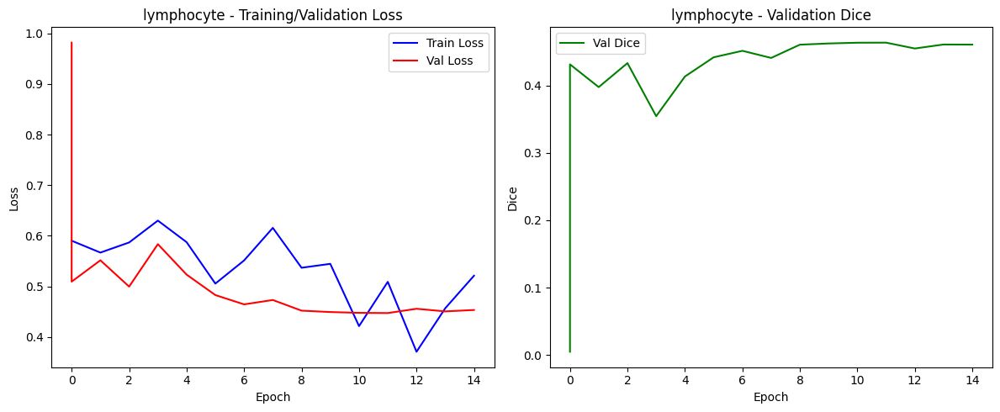


Training model 2/2 for lymphocyte

Training model for lymphocyte with configuration:
  architecture: deeplabv3plus
  encoder: resnet34
  loss_type: dice
  learning_rate: 0.0005
  batch_size: 16
Loading datasets for lymphocyte...
Found 1177 samples for lymphocyte in train split
Found 200 samples for lymphocyte in val split
Found 200 samples for lymphocyte in test split
Screening dataset for empty masks...


100%|██████████| 1177/1177 [00:29<00:00, 40.28it/s] 


Filtered out 0 empty masks out of 1177 samples (0.00%).
Remaining samples: 1177
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 126.22it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 123.80it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | DeepLabV3Plus     | 22.4 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
-----------------------------------------------------------
22.4 M    Trainable params
0         Non-trainable params
22.4 M    Total params
89.750    Total estimated model params size (MB)
175       Modules

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.250
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 74: 'val_dice' reached 0.24975 (best 0.24975), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-deeplabv3plus-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 148: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.106 >= min_delta = 0.0. New best score: 0.356
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 222: 'val_dice' reached 0.35586 (best 0.35586), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/best-lymphocyte-deeplabv3plus-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 296: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 370: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 444: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 518: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_dice did not improve in the last 5 records. Best score: 0.356. Signaling Trainer to stop.
INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 592: 'val_dice' was not in top 1
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.18596358597278595    │
│          test_f1          │    0.0323556549847126     │
│         test_loss         │    0.12049826979637146    │
│      test_precision       │    0.08652938157320023    │
│        test_recall        │    0.02151959016919136    │
└───────────────────────────┴───────────────────────────┘


Test results for lymphocyte:
  test_loss: 0.1205
  test_dice: 0.1860
  test_precision: 0.0865
  test_recall: 0.0215
  test_f1: 0.0324


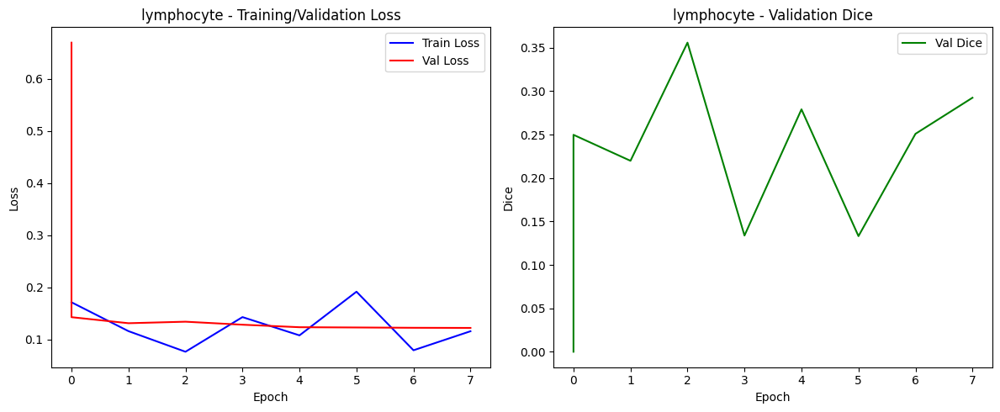


Ensemble model for lymphocyte saved to /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/lymphocyte/ensemble_lymphocyte.pt
Found 200 samples for lymphocyte in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 68.39it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200

Training ensemble for myeloid

Training ensemble for myeloid...

Training model 1/2 for myeloid

Training model for myeloid with configuration:
  architecture: deeplabv3plus
  encoder: efficientnet-b4
  loss_type: ftv
  learning_rate: 0.001
  batch_size: 16
  ftv_alpha: 0.3
  ftv_beta: 0.7
  ftv_gamma: 2.0
Loading datasets for myeloid...
Found 1070 samples for myeloid in train split
Found 200 samples for myeloid in val split
Found 200 samples for myeloid in test split
Screening dataset for empty masks...


100%|██████████| 1070/1070 [01:05<00:00, 16.44it/s] 


Filtered out 0 empty masks out of 1070 samples (0.00%).
Remaining samples: 1070
Screening dataset for empty masks...


100%|██████████| 200/200 [00:56<00:00,  3.57it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:56<00:00,  3.51it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:654: Checkpoint directory /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | DeepLabV3Plus     | 18.6 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
4 | 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/pytorch_lightning/utilities/data.py:79: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 14. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.196
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 67: 'val_dice' reached 0.19595 (best 0.19595), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.010 >= min_delta = 0.0. New best score: 0.206
INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 134: 'val_dice' reached 0.20613 (best 0.20613), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.017 >= min_delta = 0.0. New best score: 0.223
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 201: 'val_dice' reached 0.22345 (best 0.22345), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.015 >= min_delta = 0.0. New best score: 0.239
INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 268: 'val_dice' reached 0.23882 (best 0.23882), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 335: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.001 >= min_delta = 0.0. New best score: 0.240
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 402: 'val_dice' reached 0.23965 (best 0.23965), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.014 >= min_delta = 0.0. New best score: 0.254
INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 469: 'val_dice' reached 0.25393 (best 0.25393), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.010 >= min_delta = 0.0. New best score: 0.263
INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 536: 'val_dice' reached 0.26347 (best 0.26347), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.011 >= min_delta = 0.0. New best score: 0.274
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 603: 'val_dice' reached 0.27433 (best 0.27433), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.277
INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 670: 'val_dice' reached 0.27665 (best 0.27665), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.279
INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 737: 'val_dice' reached 0.27908 (best 0.27908), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.281
INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 804: 'val_dice' reached 0.28117 (best 0.28117), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.006 >= min_delta = 0.0. New best score: 0.288
INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 871: 'val_dice' reached 0.28765 (best 0.28765), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 938: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.005 >= min_delta = 0.0. New best score: 0.292
INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1005: 'val_dice' reached 0.29227 (best 0.29227), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-deeplabv3plus-efficientnet-b4-v1.ckpt' as top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.26771801710128784    │
│          test_f1          │   0.044604528695344925    │
│         test_loss         │    0.4996519386768341     │
│      test_precision       │   0.032354943454265594    │
│        test_recall        │    0.07397869229316711    │
└───────────────────────────┴───────────────────────────┘


Test results for myeloid:
  test_loss: 0.4997
  test_dice: 0.2677
  test_precision: 0.0324
  test_recall: 0.0740
  test_f1: 0.0446


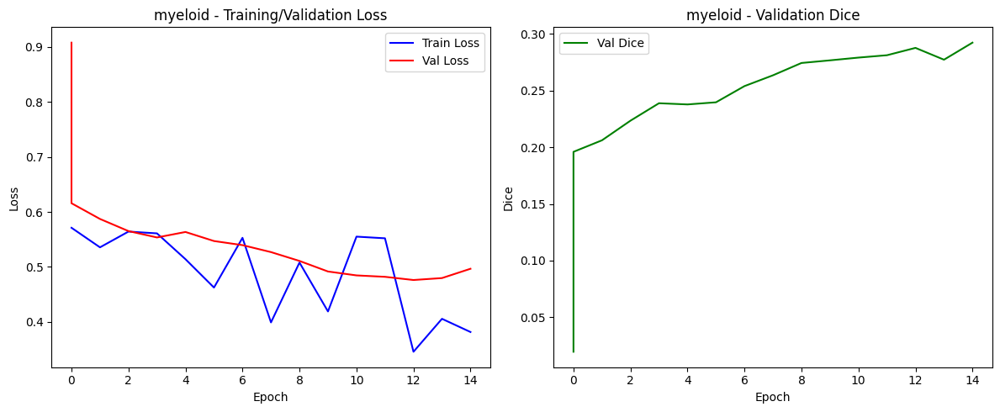


Training model 2/2 for myeloid

Training model for myeloid with configuration:
  architecture: unet
  encoder: resnet34
  loss_type: logcosh
  learning_rate: 0.0007
  batch_size: 16
Loading datasets for myeloid...
Found 1070 samples for myeloid in train split
Found 200 samples for myeloid in val split
Found 200 samples for myeloid in test split
Screening dataset for empty masks...


100%|██████████| 1070/1070 [00:28<00:00, 37.32it/s] 


Filtered out 0 empty masks out of 1070 samples (0.00%).
Remaining samples: 1070
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 135.16it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Screening dataset for empty masks...


100%|██████████| 200/200 [00:01<00:00, 135.26it/s]


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | Unet              | 24.4 M | train
1 | dice_loss    | BCEWithLogitsLoss | 0      | train
2 | bce_loss     | BCEWithLogitsLoss | 0      | train
3 | logcosh_loss | LogCoshDiceLoss   | 0      | train
-----------------------------------------------------------
24.4 M    Trainable params
0         Non-trainable params
24.4 M    Total params
97.745    Total estimated model params size (MB)
191       Modules

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved. New best score: 0.210
INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 67: 'val_dice' reached 0.21005 (best 0.21005), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 134: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.026 >= min_delta = 0.0. New best score: 0.236
INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 201: 'val_dice' reached 0.23636 (best 0.23636), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 268: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 335: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.004 >= min_delta = 0.0. New best score: 0.240
INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 402: 'val_dice' reached 0.24016 (best 0.24016), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.005 >= min_delta = 0.0. New best score: 0.246
INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 469: 'val_dice' reached 0.24557 (best 0.24557), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.012 >= min_delta = 0.0. New best score: 0.258
INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 536: 'val_dice' reached 0.25796 (best 0.25796), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.007 >= min_delta = 0.0. New best score: 0.265
INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 603: 'val_dice' reached 0.26526 (best 0.26526), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 670: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 10, global step 737: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_dice improved by 0.002 >= min_delta = 0.0. New best score: 0.268
INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 804: 'val_dice' reached 0.26763 (best 0.26763), saving model to '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/best-myeloid-unet-resnet34-v1.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 12, global step 871: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 13, global step 938: 'val_dice' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 14, global step 1005: 'val_dice' was not in top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_dice         │    0.22144295275211334    │
│          test_f1          │   0.045543041080236435    │
│         test_loss         │    0.28143858909606934    │
│      test_precision       │   0.028812717646360397    │
│        test_recall        │    0.11516103148460388    │
└───────────────────────────┴───────────────────────────┘


Test results for myeloid:
  test_loss: 0.2814
  test_dice: 0.2214
  test_precision: 0.0288
  test_recall: 0.1152
  test_f1: 0.0455


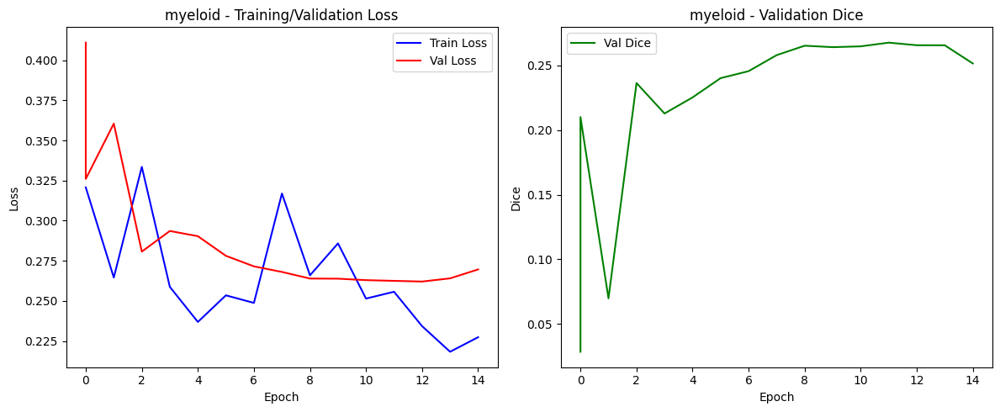


Ensemble model for myeloid saved to /content/drive/MyDrive/Bladder_Segpath_Data/checkpoints/myeloid/ensemble_myeloid.pt
Found 200 samples for myeloid in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 68.82it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200

Visualizing performance metrics...


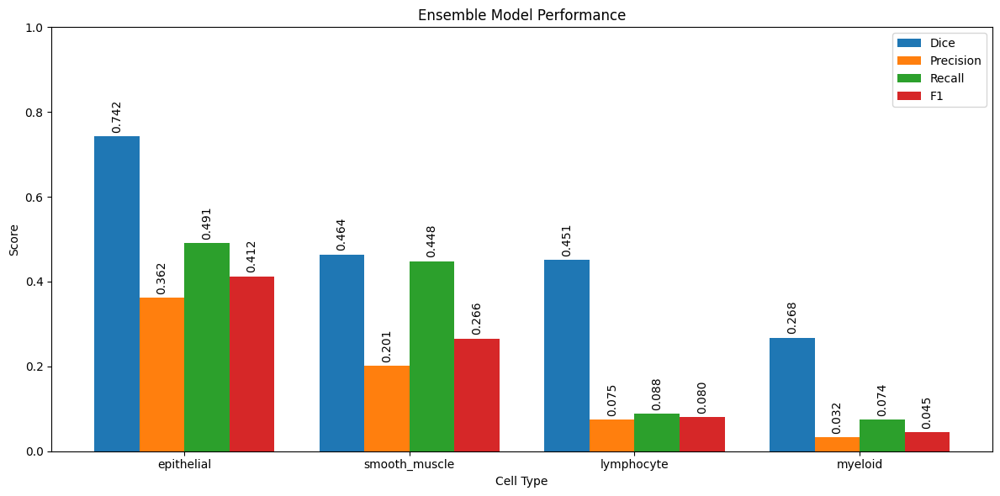


Visualizing predictions for epithelial...


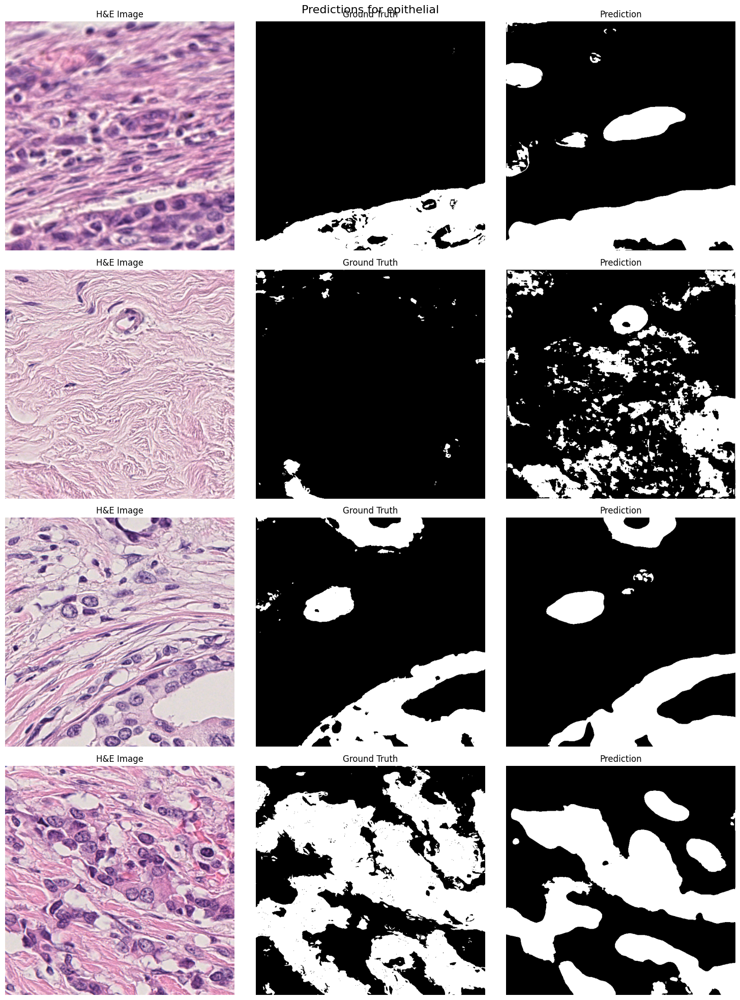


Visualizing predictions for smooth_muscle...


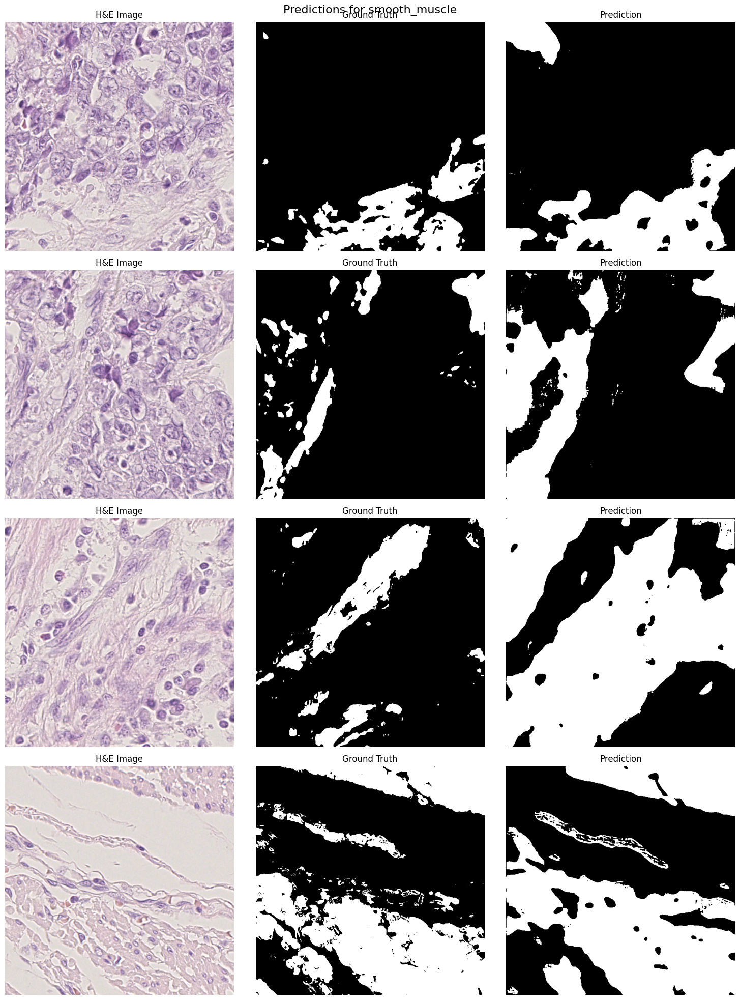


Visualizing predictions for lymphocyte...


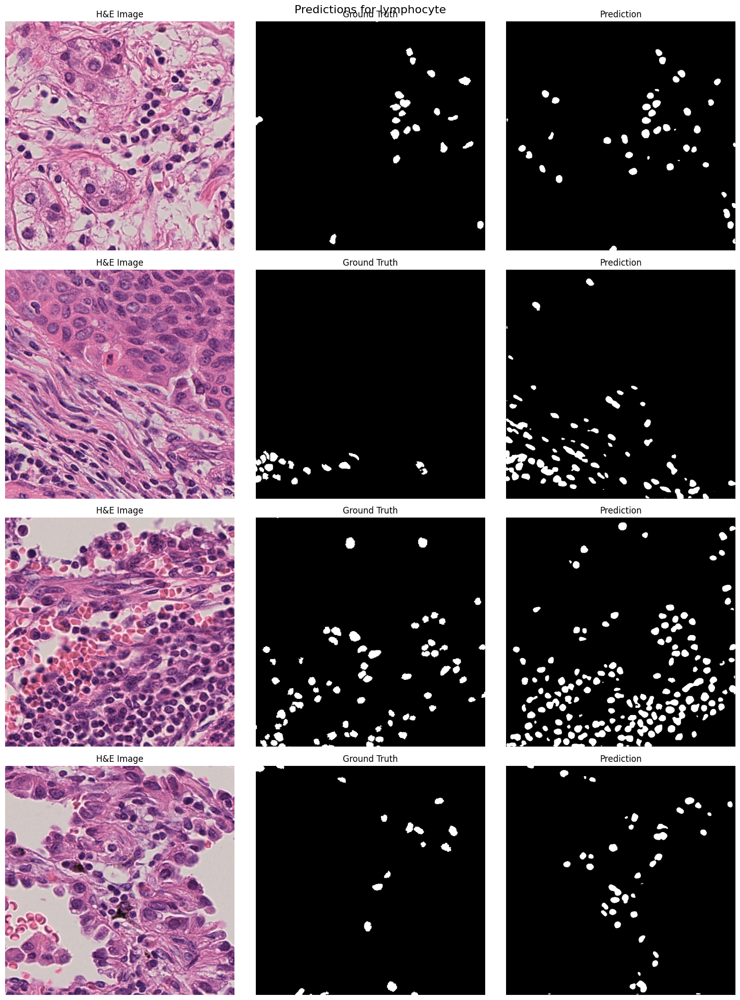


Visualizing predictions for myeloid...


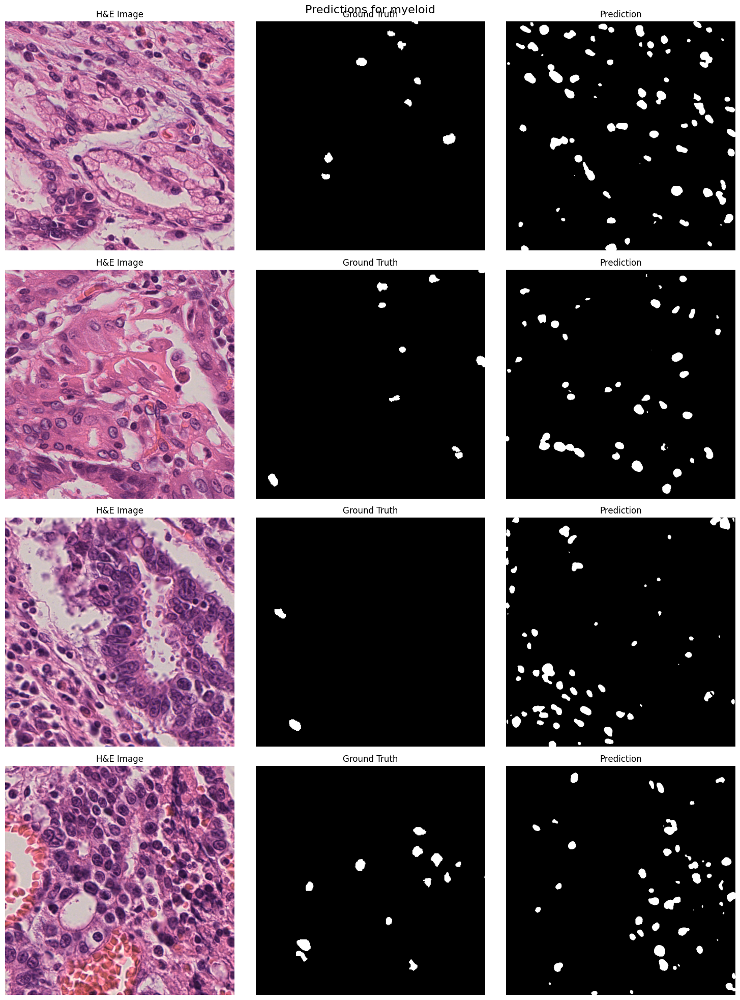


Visualizing combined segmentation...
Generating combined segmentation...


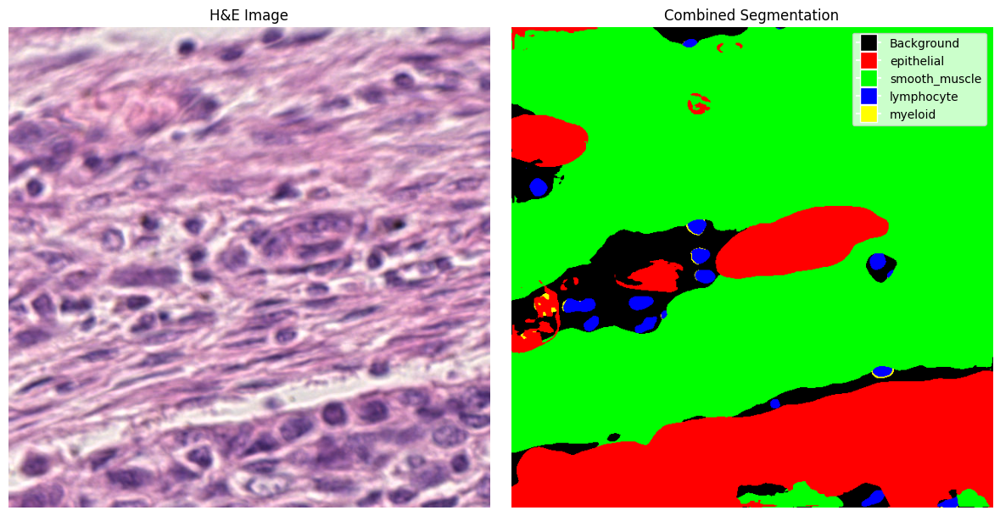


SegPath binary segmentation ensemble training complete!


In [ ]:
if __name__ == "__main__":
    print("Starting SegPath binary segmentation training...")
    ensembles, results = main()

# 15. Visualize Single Test Sample

In [ ]:
def visualize_test_sample(test_index=30, ckpt_dir=CKPT_DIR, data_dir=DATADIR):
    """
    Visualize predictions on a specific test image for each cell type.

    Args:
        test_index: Index of the test sample to visualize (default: 30)
        ckpt_dir: Directory where model checkpoints are stored
        data_dir: Directory containing the dataset
    """
    cell_types = ['epithelial', 'smooth_muscle', 'lymphocyte', 'myeloid']
    fig, axes = plt.subplots(len(cell_types), 3, figsize=(15, 5 * len(cell_types)))

    for i, cell_type in enumerate(cell_types):
        print(f"Processing {cell_type}...")

        # Step 1: Load the test dataset for this cell type
        try:
            test_dataset = SegPathBinaryDataset(root_dir=data_dir, cell_type=cell_type, split='test')
            test_dataset = filter_empty_masks(test_dataset, threshold=0.05)

            # Check if we have enough samples
            if test_index >= len(test_dataset):
                print(f"Warning: Requested index {test_index} exceeds available samples ({len(test_dataset)}) for {cell_type}")
                for j in range(3):
                    axes[i, j].text(0.5, 0.5, f"No sample {test_index} for {cell_type}",
                                   ha='center', va='center')
                    axes[i, j].axis('off')
                continue

            # Get the sample
            sample = test_dataset[test_index]
            image = sample['image'].unsqueeze(0).to(device)
            mask = sample['mask']

            # Step 2: Load the ensemble model (or best individual model)
            ensemble_path = os.path.join(ckpt_dir, cell_type, f'ensemble_{cell_type}.pt')

            if os.path.exists(ensemble_path):
                # First need to find the model architectures to create the ensemble properly
                models = []
                # Look for model checkpoints in the cell_type directory
                checkpoint_files = [f for f in os.listdir(os.path.join(ckpt_dir, cell_type))
                                   if f.startswith('best-') and f.endswith('.ckpt')]

                if checkpoint_files:
                    for ckpt_file in checkpoint_files:
                        # Load model from checkpoint
                        try:
                            model_path = os.path.join(ckpt_dir, cell_type, ckpt_file)
                            model = BinarySegmentationModel.load_from_checkpoint(model_path)
                            models.append(model)
                        except Exception as e:
                            print(f"Error loading model from {ckpt_file}: {e}")

                    if models:
                        # Create ensemble
                        ensemble = EnsembleModel(models)
                        model = ensemble
                    else:
                        print(f"No valid models found for {cell_type}, skipping...")
                        continue
                else:
                    print(f"No checkpoints found for {cell_type}, skipping...")
                    continue
            else:
                # Try to find the best individual model
                best_checkpoint = None
                best_val_dice = -1

                for f in os.listdir(os.path.join(ckpt_dir, cell_type)):
                    if f.startswith('best-') and f.endswith('.ckpt'):
                        try:
                            # Extract val_dice from filename (if available)
                            parts = f.split('-')
                            for part in parts:
                                if part.startswith('val_dice='):
                                    val_dice = float(part.split('=')[1])
                                    if val_dice > best_val_dice:
                                        best_val_dice = val_dice
                                        best_checkpoint = f
                        except:
                            # If we can't extract val_dice, just use the first one
                            if best_checkpoint is None:
                                best_checkpoint = f

                if best_checkpoint:
                    try:
                        model_path = os.path.join(ckpt_dir, cell_type, best_checkpoint)
                        model = BinarySegmentationModel.load_from_checkpoint(model_path)
                    except Exception as e:
                        print(f"Error loading model from {best_checkpoint}: {e}")
                        continue
                else:
                    print(f"No checkpoints found for {cell_type}, skipping...")
                    continue

            # Step 3: Generate prediction
            model.eval()
            with torch.no_grad():
                output = model(image)
                if isinstance(model, EnsembleModel):
                    pred = model.predict(image)
                else:
                    pred = (torch.sigmoid(output) > 0.5).float()

            # Step 4: Visualize results
            # Original H&E image
            img = image[0].cpu().numpy().transpose(1, 2, 0)
            mean = np.array([124.0/255, 116.0/255, 104.0/255])
            std = np.array([58.6/255, 57.3/255, 57.6/255])
            img = std * img + mean
            img = np.clip(img, 0, 1)

            axes[i, 0].imshow(img)
            axes[i, 0].set_title(f"{cell_type} - H&E")
            axes[i, 0].axis('off')

            # Ground truth mask
            mask_vis = mask.cpu().numpy()
            if mask_vis.ndim == 3 and mask_vis.shape[0] == 1:
                mask_vis = mask_vis.squeeze(0)

            axes[i, 1].imshow(mask_vis, cmap='gray')
            axes[i, 1].set_title(f"{cell_type} - Ground Truth")
            axes[i, 1].axis('off')

            # Prediction
            pred_vis = pred[0].cpu().numpy()
            if pred_vis.ndim == 3 and pred_vis.shape[0] == 1:
                pred_vis = pred_vis.squeeze(0)

            axes[i, 2].imshow(pred_vis, cmap='gray')
            axes[i, 2].set_title(f"{cell_type} - Prediction")
            axes[i, 2].axis('off')

        except Exception as e:
            print(f"Error processing {cell_type}: {e}")
            for j in range(3):
                axes[i, j].text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                axes[i, j].axis('off')

    plt.tight_layout()
    plt.suptitle(f"Test Sample #{test_index} for All Cell Types", y=1.02, fontsize=16)
    plt.show()

    return fig

Processing epithelial...
Found 200 samples for epithelial in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 92.00it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Processing smooth_muscle...
Found 200 samples for smooth_muscle in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 85.41it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Processing lymphocyte...
Found 200 samples for lymphocyte in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:03<00:00, 62.02it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200
Processing myeloid...
Found 200 samples for myeloid in test split
Screening dataset for empty masks...


100%|██████████| 200/200 [00:02<00:00, 80.63it/s] 


Filtered out 0 empty masks out of 200 samples (0.00%).
Remaining samples: 200


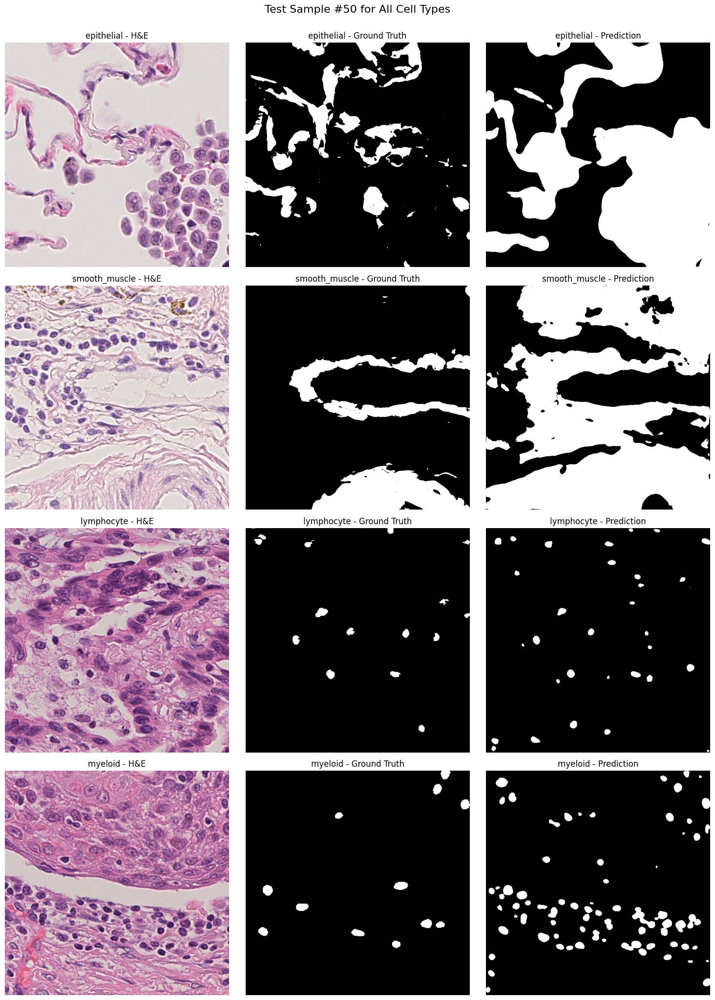

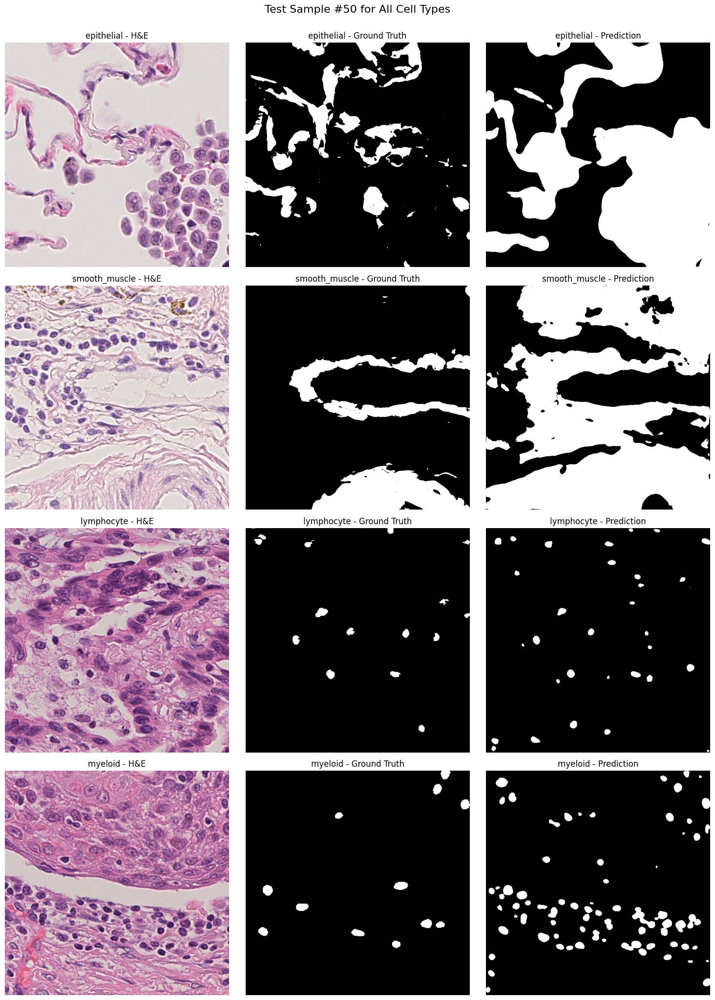

In [ ]:
visualize_test_sample(50)

## 16. Apply model on H&E

In [ ]:
!apt update && apt install -y openslide-tools
!pip install openslide-python
!pip install segmentation-models-pytorch

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:6 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:7 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Get:8 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Get:11 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,540 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [3,097 kB]
Fetched 4,894 kB in 3s (1,617 kB/s)
Reading package lists... Done
Building dependency tree... Don

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Using device: cuda
Loading model for epithelial...
  Loaded model from best-epithelial-unet-resnet34.ckpt
Loading model for smooth_muscle...
  Loaded model from best-smooth_muscle-unet-resnet34.ckpt
Loading model for lymphocyte...
  Loaded model from best-lymphocyte-unet-resnet34.ckpt
Loading model for myeloid...
  Loaded model from best-myeloid-unet-efficientnet-b4.ckpt
Found 8 SVS files to process

Processing ss12084_1_4_090801.svs...
Detecting tissue regions...


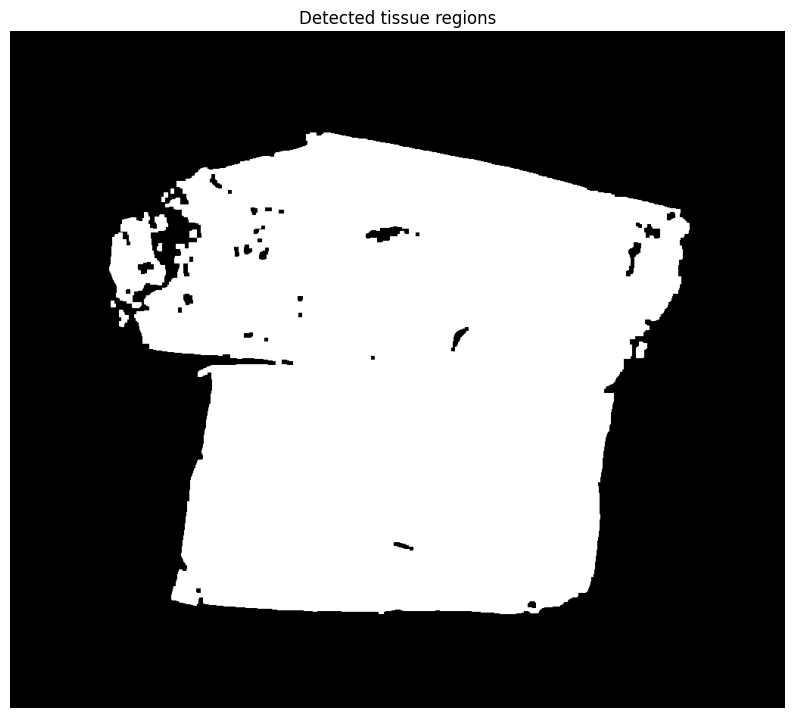

Detected 6 tissue regions
Processing region 1/6 of size 844x1080
  Processing tile at (46550, 20136) with 2 patches...


100%|██████████| 2/2 [00:01<00:00,  1.19it/s]


Processing region 2/6 of size 731x1129
  Processing tile at (8105, 18073) with 2 patches...


100%|██████████| 2/2 [00:00<00:00,  8.97it/s]


Processing region 3/6 of size 394x540
Processing region 4/6 of size 4390x6237
  Processing tile at (7373, 11737) with 168 patches...


100%|██████████| 168/168 [00:09<00:00, 17.45it/s]


  Processing tile at (7373, 16737) with 24 patches...


100%|██████████| 24/24 [00:02<00:00, 10.77it/s]


Processing region 5/6 of size 506x638
Processing region 6/6 of size 41315x31235
  Processing tile at (9231, 6581) with 196 patches...


100%|██████████| 196/196 [00:04<00:00, 43.23it/s]


  Processing tile at (14231, 6581) with 196 patches...


100%|██████████| 196/196 [00:08<00:00, 23.07it/s]


  Processing tile at (19231, 6581) with 196 patches...


100%|██████████| 196/196 [00:13<00:00, 14.89it/s]


  Processing tile at (24231, 6581) with 196 patches...


100%|██████████| 196/196 [00:13<00:00, 14.19it/s]


  Processing tile at (29231, 6581) with 196 patches...


100%|██████████| 196/196 [00:13<00:00, 14.39it/s]


  Processing tile at (34231, 6581) with 196 patches...


100%|██████████| 196/196 [00:15<00:00, 12.99it/s]


  Processing tile at (39231, 6581) with 196 patches...


100%|██████████| 196/196 [00:05<00:00, 38.34it/s]


  Processing tile at (44231, 6581) with 196 patches...


100%|██████████| 196/196 [00:04<00:00, 46.66it/s]


  Processing tile at (49231, 6581) with 42 patches...


100%|██████████| 42/42 [00:04<00:00,  9.30it/s]


  Processing tile at (9231, 11581) with 196 patches...


100%|██████████| 196/196 [00:13<00:00, 14.32it/s]


  Processing tile at (14231, 11581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.48it/s]


  Processing tile at (19231, 11581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.52it/s]


  Processing tile at (24231, 11581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.74it/s]


  Processing tile at (29231, 11581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.56it/s]


  Processing tile at (34231, 11581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (39231, 11581) with 196 patches...


100%|██████████| 196/196 [00:19<00:00, 10.00it/s]


  Processing tile at (44231, 11581) with 196 patches...


100%|██████████| 196/196 [00:26<00:00,  7.37it/s]


  Processing tile at (49231, 11581) with 42 patches...


100%|██████████| 42/42 [00:06<00:00,  6.58it/s]


  Processing tile at (9231, 16581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 12.08it/s]


  Processing tile at (14231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.38it/s]


  Processing tile at (19231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.46it/s]


  Processing tile at (24231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (29231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (34231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (39231, 16581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.48it/s]


  Processing tile at (44231, 16581) with 196 patches...


100%|██████████| 196/196 [00:32<00:00,  6.12it/s]


  Processing tile at (49231, 16581) with 42 patches...


100%|██████████| 42/42 [00:05<00:00,  7.39it/s]


  Processing tile at (9231, 21581) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 19.51it/s]


  Processing tile at (14231, 21581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 12.03it/s]


  Processing tile at (19231, 21581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.49it/s]


  Processing tile at (24231, 21581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.54it/s]


  Processing tile at (29231, 21581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (34231, 21581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (39231, 21581) with 196 patches...


100%|██████████| 196/196 [00:22<00:00,  8.57it/s]


  Processing tile at (44231, 21581) with 196 patches...


100%|██████████| 196/196 [00:26<00:00,  7.51it/s]


  Processing tile at (49231, 21581) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 44.42it/s]


  Processing tile at (9231, 26581) with 196 patches...


100%|██████████| 196/196 [00:04<00:00, 48.52it/s]


  Processing tile at (14231, 26581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.65it/s]


  Processing tile at (19231, 26581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (24231, 26581) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.54it/s]


  Processing tile at (29231, 26581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (34231, 26581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (39231, 26581) with 196 patches...


100%|██████████| 196/196 [00:24<00:00,  8.11it/s]


  Processing tile at (44231, 26581) with 196 patches...


100%|██████████| 196/196 [00:12<00:00, 16.24it/s]


  Processing tile at (49231, 26581) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 44.05it/s]


  Processing tile at (9231, 31581) with 196 patches...


100%|██████████| 196/196 [00:05<00:00, 32.77it/s]


  Processing tile at (14231, 31581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (19231, 31581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (24231, 31581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.48it/s]


  Processing tile at (29231, 31581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.52it/s]


  Processing tile at (34231, 31581) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.33it/s]


  Processing tile at (39231, 31581) with 196 patches...


100%|██████████| 196/196 [00:37<00:00,  5.20it/s]


  Processing tile at (44231, 31581) with 196 patches...


100%|██████████| 196/196 [00:04<00:00, 41.30it/s]


  Processing tile at (49231, 31581) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 44.00it/s]


  Processing tile at (9231, 36581) with 28 patches...


100%|██████████| 28/28 [00:01<00:00, 24.59it/s]


  Processing tile at (14231, 36581) with 28 patches...


100%|██████████| 28/28 [00:02<00:00, 10.92it/s]


  Processing tile at (19231, 36581) with 28 patches...


100%|██████████| 28/28 [00:02<00:00, 11.05it/s]


  Processing tile at (24231, 36581) with 28 patches...


100%|██████████| 28/28 [00:02<00:00, 11.12it/s]


  Processing tile at (29231, 36581) with 28 patches...


100%|██████████| 28/28 [00:02<00:00, 11.16it/s]


  Processing tile at (34231, 36581) with 28 patches...


100%|██████████| 28/28 [00:02<00:00, 10.78it/s]


  Processing tile at (39231, 36581) with 28 patches...


100%|██████████| 28/28 [00:04<00:00,  5.88it/s]


  Processing tile at (44231, 36581) with 28 patches...


100%|██████████| 28/28 [00:00<00:00, 41.81it/s]


  Processing tile at (49231, 36581) with 6 patches...


100%|██████████| 6/6 [00:00<00:00, 39.20it/s]


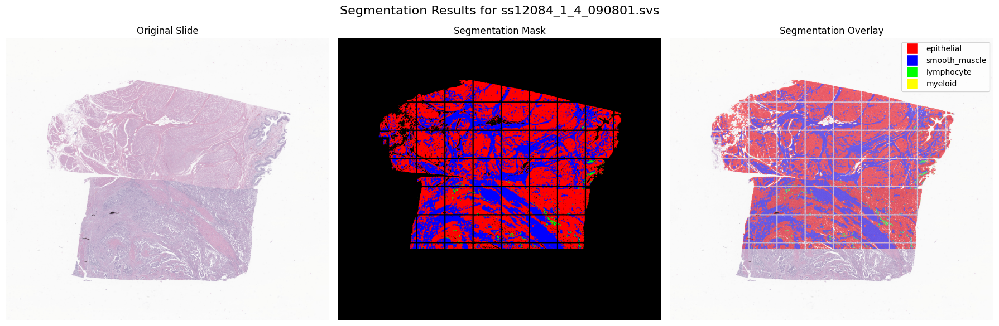

  Segmentation completed for ss12084_1_4_090801.svs

Processing ss12084_1_5_090909.svs...
Detecting tissue regions...


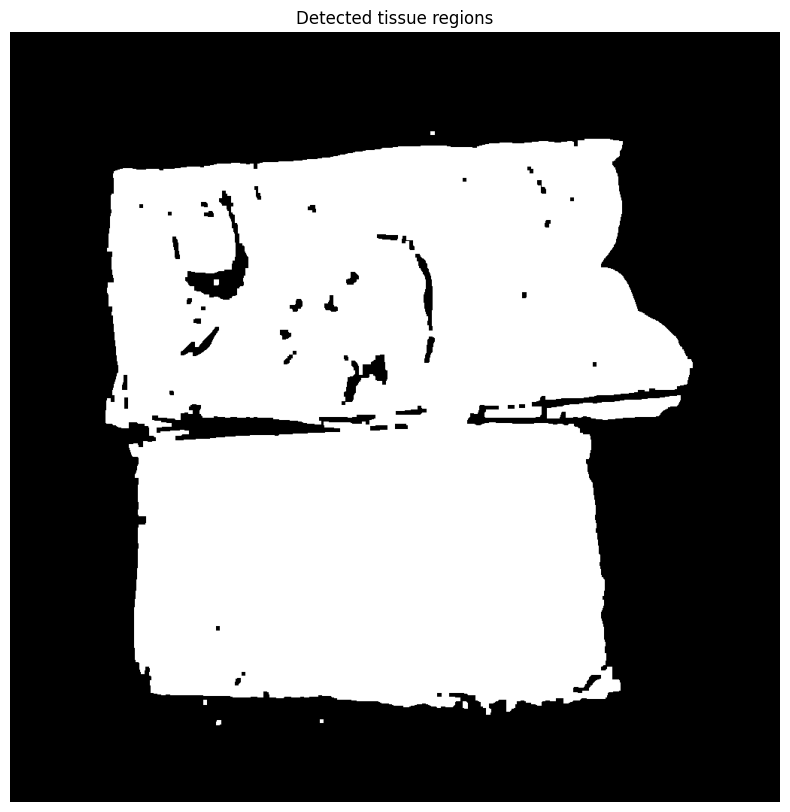

Detected 3 tissue regions
Processing region 1/3 of size 417x595
Processing region 2/3 of size 10606x1966
  Processing tile at (42543, 28779) with 70 patches...


100%|██████████| 70/70 [00:05<00:00, 12.10it/s]


  Processing tile at (47543, 28779) with 70 patches...


100%|██████████| 70/70 [00:06<00:00, 11.48it/s]


Processing region 3/3 of size 46535x45642
  Processing tile at (7567, 8461) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 18.13it/s]


  Processing tile at (12567, 8461) with 196 patches...


100%|██████████| 196/196 [00:11<00:00, 16.63it/s]


  Processing tile at (17567, 8461) with 196 patches...


100%|██████████| 196/196 [00:12<00:00, 15.45it/s]


  Processing tile at (22567, 8461) with 196 patches...


100%|██████████| 196/196 [00:13<00:00, 14.03it/s]


  Processing tile at (27567, 8461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 12.23it/s]


  Processing tile at (32567, 8461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.88it/s]


  Processing tile at (37567, 8461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.49it/s]


  Processing tile at (42567, 8461) with 196 patches...


100%|██████████| 196/196 [00:25<00:00,  7.63it/s]


  Processing tile at (47567, 8461) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 19.02it/s]


  Processing tile at (52567, 8461) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 43.21it/s]


  Processing tile at (7567, 13461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (12567, 13461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.59it/s]


  Processing tile at (17567, 13461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.73it/s]


  Processing tile at (22567, 13461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.55it/s]


  Processing tile at (27567, 13461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.65it/s]


  Processing tile at (32567, 13461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.56it/s]


  Processing tile at (37567, 13461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (42567, 13461) with 196 patches...


100%|██████████| 196/196 [00:36<00:00,  5.39it/s]


  Processing tile at (47567, 13461) with 196 patches...


100%|██████████| 196/196 [00:11<00:00, 17.11it/s]


  Processing tile at (52567, 13461) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 44.78it/s]


  Processing tile at (7567, 18461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.64it/s]


  Processing tile at (12567, 18461) with 196 patches...


100%|██████████| 196/196 [00:15<00:00, 13.00it/s]


  Processing tile at (17567, 18461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.96it/s]


  Processing tile at (22567, 18461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (27567, 18461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.55it/s]


  Processing tile at (32567, 18461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.84it/s]


  Processing tile at (37567, 18461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.61it/s]


  Processing tile at (42567, 18461) with 196 patches...


100%|██████████| 196/196 [00:26<00:00,  7.48it/s]


  Processing tile at (47567, 18461) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 17.89it/s]


  Processing tile at (52567, 18461) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 45.15it/s]


  Processing tile at (7567, 23461) with 196 patches...


100%|██████████| 196/196 [00:15<00:00, 12.43it/s]


  Processing tile at (12567, 23461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.49it/s]


  Processing tile at (17567, 23461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (22567, 23461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.68it/s]


  Processing tile at (27567, 23461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.92it/s]


  Processing tile at (32567, 23461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.54it/s]


  Processing tile at (37567, 23461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.40it/s]


  Processing tile at (42567, 23461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.45it/s]


  Processing tile at (47567, 23461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.50it/s]


  Processing tile at (52567, 23461) with 42 patches...


100%|██████████| 42/42 [00:03<00:00, 13.04it/s]


  Processing tile at (7567, 28461) with 196 patches...


100%|██████████| 196/196 [00:14<00:00, 13.64it/s]


  Processing tile at (12567, 28461) with 196 patches...


100%|██████████| 196/196 [00:14<00:00, 13.50it/s]


  Processing tile at (17567, 28461) with 196 patches...


100%|██████████| 196/196 [00:14<00:00, 13.13it/s]


  Processing tile at (22567, 28461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.85it/s]


  Processing tile at (27567, 28461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.64it/s]


  Processing tile at (32567, 28461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.56it/s]


  Processing tile at (37567, 28461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.58it/s]


  Processing tile at (42567, 28461) with 196 patches...


100%|██████████| 196/196 [00:14<00:00, 13.69it/s]


  Processing tile at (47567, 28461) with 196 patches...


100%|██████████| 196/196 [00:09<00:00, 20.57it/s]


  Processing tile at (52567, 28461) with 42 patches...


100%|██████████| 42/42 [00:01<00:00, 29.91it/s]


  Processing tile at (7567, 33461) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 17.98it/s]


  Processing tile at (12567, 33461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.56it/s]


  Processing tile at (17567, 33461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.42it/s]


  Processing tile at (22567, 33461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.51it/s]


  Processing tile at (27567, 33461) with 196 patches...


100%|██████████| 196/196 [00:17<00:00, 11.47it/s]


  Processing tile at (32567, 33461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.60it/s]


  Processing tile at (37567, 33461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.54it/s]


  Processing tile at (42567, 33461) with 196 patches...


100%|██████████| 196/196 [00:14<00:00, 13.59it/s]


  Processing tile at (47567, 33461) with 196 patches...


100%|██████████| 196/196 [00:04<00:00, 47.72it/s]


  Processing tile at (52567, 33461) with 42 patches...


100%|██████████| 42/42 [00:00<00:00, 44.50it/s]


  Processing tile at (7567, 38461) with 196 patches...


100%|██████████| 196/196 [00:10<00:00, 18.71it/s]


  Processing tile at (12567, 38461) with 196 patches...


100%|██████████| 196/196 [00:16<00:00, 11.56it/s]


  Processing tile at (17567, 38461) with 196 patches...


100%|██████████| 196/196 [00:29<00:00,  6.63it/s]


  Processing tile at (22567, 38461) with 196 patches...


100%|██████████| 196/196 [00:46<00:00,  4.18it/s]


  Processing tile at (27567, 38461) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.02it/s]


  Processing tile at (32567, 38461) with 196 patches...


100%|██████████| 196/196 [00:54<00:00,  3.59it/s]


  Processing tile at (37567, 38461) with 196 patches...


100%|██████████| 196/196 [00:53<00:00,  3.65it/s]


  Processing tile at (42567, 38461) with 196 patches...


100%|██████████| 196/196 [00:47<00:00,  4.10it/s]


  Processing tile at (47567, 38461) with 196 patches...


100%|██████████| 196/196 [00:05<00:00, 37.62it/s]


  Processing tile at (52567, 38461) with 42 patches...


100%|██████████| 42/42 [00:01<00:00, 27.02it/s]


  Processing tile at (7567, 43461) with 196 patches...


100%|██████████| 196/196 [01:49<00:00,  1.79it/s]


  Processing tile at (12567, 43461) with 196 patches...


100%|██████████| 196/196 [01:26<00:00,  2.26it/s]


  Processing tile at (17567, 43461) with 196 patches...


100%|██████████| 196/196 [01:19<00:00,  2.47it/s]


  Processing tile at (22567, 43461) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.69it/s]


  Processing tile at (27567, 43461) with 196 patches...


100%|██████████| 196/196 [01:17<00:00,  2.52it/s]


  Processing tile at (32567, 43461) with 196 patches...


100%|██████████| 196/196 [01:28<00:00,  2.22it/s]


  Processing tile at (37567, 43461) with 196 patches...


100%|██████████| 196/196 [01:36<00:00,  2.03it/s]


  Processing tile at (42567, 43461) with 196 patches...


100%|██████████| 196/196 [01:09<00:00,  2.82it/s]


  Processing tile at (47567, 43461) with 196 patches...


100%|██████████| 196/196 [00:06<00:00, 30.32it/s]


  Processing tile at (52567, 43461) with 42 patches...


100%|██████████| 42/42 [00:02<00:00, 19.86it/s]


  Processing tile at (7567, 48461) with 196 patches...


100%|██████████| 196/196 [01:39<00:00,  1.96it/s]


  Processing tile at (12567, 48461) with 196 patches...


100%|██████████| 196/196 [01:03<00:00,  3.09it/s]


  Processing tile at (17567, 48461) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  2.99it/s]


  Processing tile at (22567, 48461) with 196 patches...


100%|██████████| 196/196 [01:06<00:00,  2.93it/s]


  Processing tile at (27567, 48461) with 196 patches...


100%|██████████| 196/196 [01:31<00:00,  2.15it/s]


  Processing tile at (32567, 48461) with 196 patches...


100%|██████████| 196/196 [01:17<00:00,  2.53it/s]


  Processing tile at (37567, 48461) with 196 patches...


100%|██████████| 196/196 [01:34<00:00,  2.08it/s]


  Processing tile at (42567, 48461) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.90it/s]


  Processing tile at (47567, 48461) with 196 patches...


100%|██████████| 196/196 [00:08<00:00, 23.25it/s]


  Processing tile at (52567, 48461) with 42 patches...


100%|██████████| 42/42 [00:02<00:00, 20.22it/s]


  Processing tile at (7567, 53461) with 14 patches...


100%|██████████| 14/14 [00:06<00:00,  2.14it/s]


  Processing tile at (12567, 53461) with 14 patches...


100%|██████████| 14/14 [00:06<00:00,  2.16it/s]


  Processing tile at (17567, 53461) with 14 patches...


100%|██████████| 14/14 [00:02<00:00,  5.26it/s]


  Processing tile at (22567, 53461) with 14 patches...


100%|██████████| 14/14 [00:08<00:00,  1.70it/s]


  Processing tile at (27567, 53461) with 14 patches...


100%|██████████| 14/14 [00:06<00:00,  2.30it/s]


  Processing tile at (32567, 53461) with 14 patches...


100%|██████████| 14/14 [00:06<00:00,  2.29it/s]


  Processing tile at (37567, 53461) with 14 patches...


100%|██████████| 14/14 [00:05<00:00,  2.75it/s]


  Processing tile at (42567, 53461) with 14 patches...


100%|██████████| 14/14 [00:00<00:00, 31.38it/s]


  Processing tile at (47567, 53461) with 14 patches...


100%|██████████| 14/14 [00:03<00:00,  4.21it/s]


  Processing tile at (52567, 53461) with 3 patches...


100%|██████████| 3/3 [00:01<00:00,  1.64it/s]


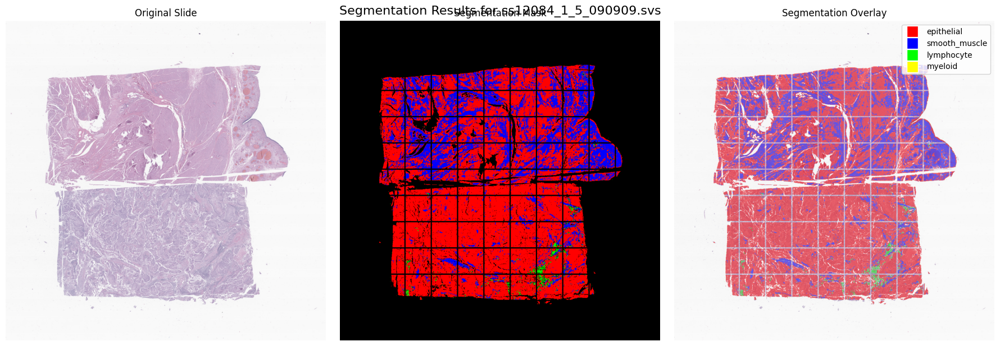

  Segmentation completed for ss12084_1_5_090909.svs

Processing ss12084_1_6_091008.svs...
Detecting tissue regions...


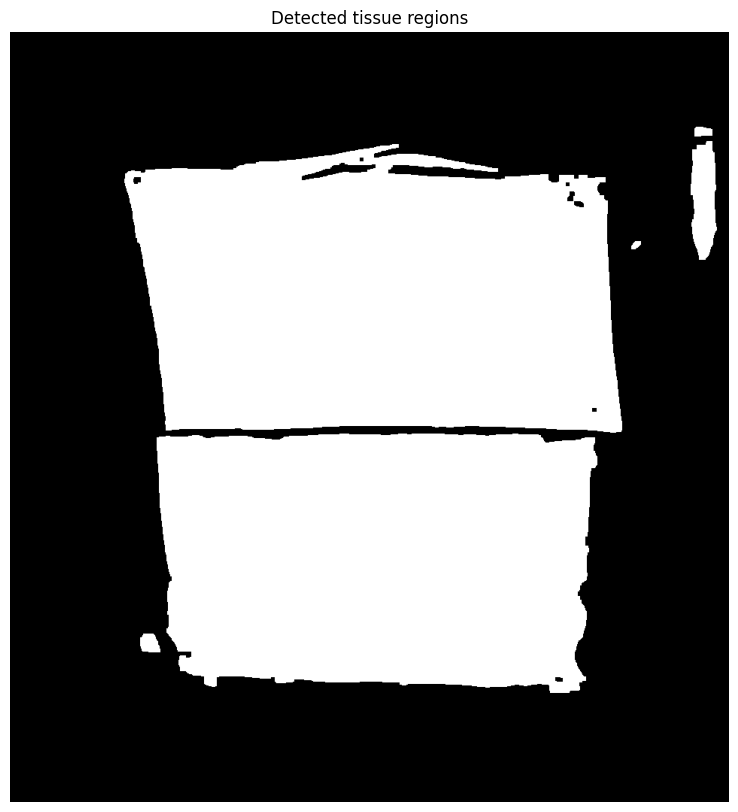

Detected 6 tissue regions
Processing region 1/6 of size 1247x1237
  Processing tile at (7993, 39600) with 4 patches...


100%|██████████| 4/4 [00:16<00:00,  4.22s/it]


Processing region 2/6 of size 27075x17077
  Processing tile at (9009, 26433) with 196 patches...


100%|██████████| 196/196 [02:10<00:00,  1.50it/s]


  Processing tile at (14009, 26433) with 196 patches...


100%|██████████| 196/196 [01:13<00:00,  2.67it/s]


  Processing tile at (19009, 26433) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.39it/s]


  Processing tile at (24009, 26433) with 196 patches...


100%|██████████| 196/196 [01:15<00:00,  2.61it/s]


  Processing tile at (29009, 26433) with 196 patches...


100%|██████████| 196/196 [01:26<00:00,  2.25it/s]


  Processing tile at (34009, 26433) with 70 patches...


100%|██████████| 70/70 [00:23<00:00,  3.01it/s]


  Processing tile at (9009, 31433) with 196 patches...


100%|██████████| 196/196 [01:41<00:00,  1.93it/s]


  Processing tile at (14009, 31433) with 196 patches...


100%|██████████| 196/196 [01:15<00:00,  2.59it/s]


  Processing tile at (19009, 31433) with 196 patches...


100%|██████████| 196/196 [01:23<00:00,  2.35it/s]


  Processing tile at (24009, 31433) with 196 patches...


100%|██████████| 196/196 [01:15<00:00,  2.60it/s]


  Processing tile at (29009, 31433) with 196 patches...


100%|██████████| 196/196 [01:25<00:00,  2.29it/s]


  Processing tile at (34009, 31433) with 70 patches...


100%|██████████| 70/70 [00:36<00:00,  1.89it/s]


  Processing tile at (9009, 36433) with 196 patches...


100%|██████████| 196/196 [00:50<00:00,  3.91it/s]


  Processing tile at (14009, 36433) with 196 patches...


100%|██████████| 196/196 [00:35<00:00,  5.48it/s]


  Processing tile at (19009, 36433) with 196 patches...


100%|██████████| 196/196 [00:55<00:00,  3.54it/s]


  Processing tile at (24009, 36433) with 196 patches...


100%|██████████| 196/196 [00:42<00:00,  4.64it/s]


  Processing tile at (29009, 36433) with 196 patches...


100%|██████████| 196/196 [01:00<00:00,  3.25it/s]


  Processing tile at (34009, 36433) with 70 patches...


100%|██████████| 70/70 [00:27<00:00,  2.58it/s]


  Processing tile at (9009, 41433) with 70 patches...


100%|██████████| 70/70 [00:28<00:00,  2.43it/s]


  Processing tile at (14009, 41433) with 70 patches...


100%|██████████| 70/70 [00:28<00:00,  2.49it/s]


  Processing tile at (19009, 41433) with 70 patches...


100%|██████████| 70/70 [00:26<00:00,  2.64it/s]


  Processing tile at (24009, 41433) with 70 patches...


100%|██████████| 70/70 [00:18<00:00,  3.72it/s]


  Processing tile at (29009, 41433) with 70 patches...


100%|██████████| 70/70 [00:32<00:00,  2.16it/s]


  Processing tile at (34009, 41433) with 25 patches...


100%|██████████| 25/25 [00:17<00:00,  1.40it/s]


Processing region 3/6 of size 600x544
Processing region 4/6 of size 30586x19008
  Processing tile at (7022, 7375) with 196 patches...


100%|██████████| 196/196 [01:22<00:00,  2.39it/s]


  Processing tile at (12022, 7375) with 196 patches...


100%|██████████| 196/196 [00:57<00:00,  3.41it/s]


  Processing tile at (17022, 7375) with 196 patches...


100%|██████████| 196/196 [00:54<00:00,  3.57it/s]


  Processing tile at (22022, 7375) with 196 patches...


100%|██████████| 196/196 [01:06<00:00,  2.93it/s]


  Processing tile at (27022, 7375) with 196 patches...


100%|██████████| 196/196 [00:55<00:00,  3.54it/s]


  Processing tile at (32022, 7375) with 196 patches...


100%|██████████| 196/196 [00:51<00:00,  3.78it/s]


  Processing tile at (7022, 12375) with 196 patches...


100%|██████████| 196/196 [01:38<00:00,  1.98it/s]


  Processing tile at (12022, 12375) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  2.99it/s]


  Processing tile at (17022, 12375) with 196 patches...


100%|██████████| 196/196 [01:20<00:00,  2.45it/s]


  Processing tile at (22022, 12375) with 196 patches...


100%|██████████| 196/196 [01:14<00:00,  2.62it/s]


  Processing tile at (27022, 12375) with 196 patches...


100%|██████████| 196/196 [01:22<00:00,  2.36it/s]


  Processing tile at (32022, 12375) with 196 patches...


100%|██████████| 196/196 [01:16<00:00,  2.57it/s]


  Processing tile at (7022, 17375) with 196 patches...


100%|██████████| 196/196 [01:24<00:00,  2.31it/s]


  Processing tile at (12022, 17375) with 196 patches...


100%|██████████| 196/196 [01:13<00:00,  2.66it/s]


  Processing tile at (17022, 17375) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  3.00it/s]


  Processing tile at (22022, 17375) with 196 patches...


100%|██████████| 196/196 [01:13<00:00,  2.66it/s]


  Processing tile at (27022, 17375) with 196 patches...


100%|██████████| 196/196 [01:11<00:00,  2.76it/s]


  Processing tile at (32022, 17375) with 196 patches...


100%|██████████| 196/196 [01:16<00:00,  2.58it/s]


  Processing tile at (7022, 22375) with 154 patches...


100%|██████████| 154/154 [01:15<00:00,  2.03it/s]


  Processing tile at (12022, 22375) with 154 patches...


100%|██████████| 154/154 [01:04<00:00,  2.39it/s]


  Processing tile at (17022, 22375) with 154 patches...


100%|██████████| 154/154 [00:56<00:00,  2.71it/s]


  Processing tile at (22022, 22375) with 154 patches...


100%|██████████| 154/154 [00:50<00:00,  3.04it/s]


  Processing tile at (27022, 22375) with 154 patches...


100%|██████████| 154/154 [00:40<00:00,  3.84it/s]


  Processing tile at (32022, 22375) with 154 patches...


100%|██████████| 154/154 [00:54<00:00,  2.84it/s]


Processing region 5/6 of size 1617x7821
  Processing tile at (41813, 7177) with 56 patches...


100%|██████████| 56/56 [00:12<00:00,  4.58it/s]


  Processing tile at (41813, 12177) with 28 patches...


100%|██████████| 28/28 [00:09<00:00,  2.87it/s]


Processing region 6/6 of size 1108x643
  Processing tile at (42044, 6237) with 2 patches...


100%|██████████| 2/2 [00:04<00:00,  2.33s/it]


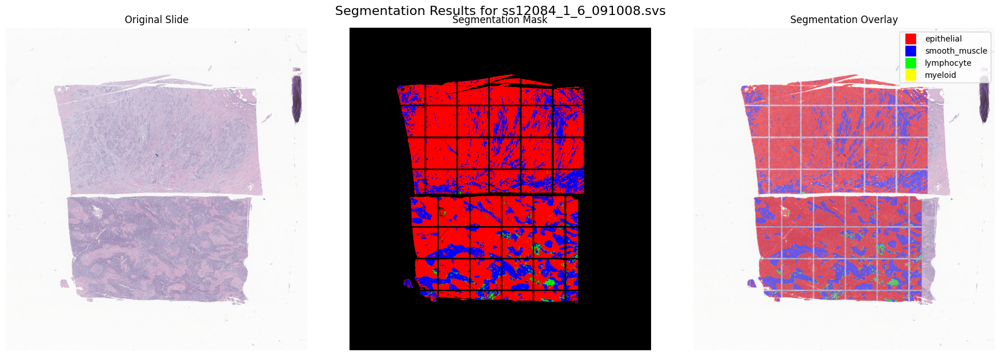

  Segmentation completed for ss12084_1_6_091008.svs

Processing ss12084_1_7_091102.svs...
Detecting tissue regions...


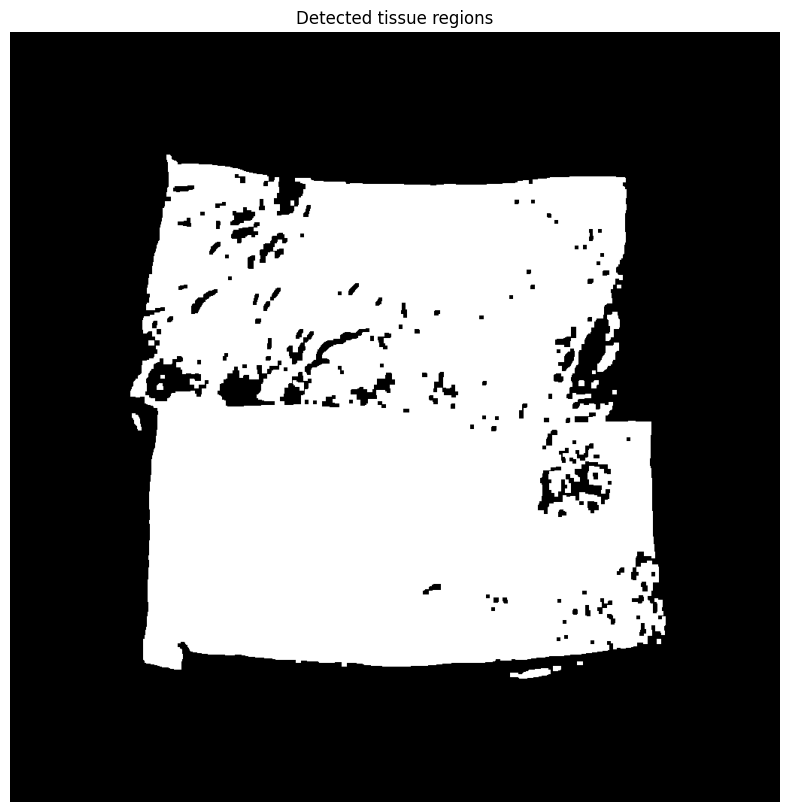

Detected 7 tissue regions
Processing region 1/7 of size 2494x646
  Processing tile at (30725, 39087) with 6 patches...


100%|██████████| 6/6 [00:12<00:00,  2.05s/it]


Processing region 2/7 of size 508x323
Processing region 3/7 of size 600x1062
Processing region 4/7 of size 462x508
Processing region 5/7 of size 1339x1801
  Processing tile at (36084, 19081) with 12 patches...


100%|██████████| 12/12 [00:25<00:00,  2.09s/it]


Processing region 6/7 of size 877x1801
  Processing tile at (36592, 17187) with 4 patches...


100%|██████████| 4/4 [00:19<00:00,  4.87s/it]


Processing region 7/7 of size 32896x31649
  Processing tile at (7392, 7531) with 196 patches...


100%|██████████| 196/196 [01:39<00:00,  1.98it/s]


  Processing tile at (12392, 7531) with 196 patches...


100%|██████████| 196/196 [00:54<00:00,  3.58it/s]


  Processing tile at (17392, 7531) with 196 patches...


100%|██████████| 196/196 [00:57<00:00,  3.43it/s]


  Processing tile at (22392, 7531) with 196 patches...


100%|██████████| 196/196 [01:26<00:00,  2.27it/s]


  Processing tile at (27392, 7531) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.91it/s]


  Processing tile at (32392, 7531) with 196 patches...


100%|██████████| 196/196 [01:00<00:00,  3.22it/s]


  Processing tile at (37392, 7531) with 112 patches...


100%|██████████| 112/112 [00:08<00:00, 13.64it/s]


  Processing tile at (7392, 12531) with 196 patches...


100%|██████████| 196/196 [01:37<00:00,  2.02it/s]


  Processing tile at (12392, 12531) with 196 patches...


100%|██████████| 196/196 [00:59<00:00,  3.30it/s]


  Processing tile at (17392, 12531) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.04it/s]


  Processing tile at (22392, 12531) with 196 patches...


100%|██████████| 196/196 [01:15<00:00,  2.58it/s]


  Processing tile at (27392, 12531) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.40it/s]


  Processing tile at (32392, 12531) with 196 patches...


100%|██████████| 196/196 [00:55<00:00,  3.54it/s]


  Processing tile at (37392, 12531) with 112 patches...


100%|██████████| 112/112 [00:05<00:00, 21.91it/s]


  Processing tile at (7392, 17531) with 196 patches...


100%|██████████| 196/196 [01:55<00:00,  1.70it/s]


  Processing tile at (12392, 17531) with 196 patches...


100%|██████████| 196/196 [01:02<00:00,  3.12it/s]


  Processing tile at (17392, 17531) with 196 patches...


100%|██████████| 196/196 [00:55<00:00,  3.52it/s]


  Processing tile at (22392, 17531) with 196 patches...


100%|██████████| 196/196 [00:59<00:00,  3.27it/s]


  Processing tile at (27392, 17531) with 196 patches...


100%|██████████| 196/196 [01:13<00:00,  2.66it/s]


  Processing tile at (32392, 17531) with 196 patches...


100%|██████████| 196/196 [00:42<00:00,  4.64it/s]


  Processing tile at (37392, 17531) with 112 patches...


100%|██████████| 112/112 [00:07<00:00, 14.29it/s]


  Processing tile at (7392, 22531) with 196 patches...


100%|██████████| 196/196 [01:59<00:00,  1.65it/s]


  Processing tile at (12392, 22531) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  3.00it/s]


  Processing tile at (17392, 22531) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.92it/s]


  Processing tile at (22392, 22531) with 196 patches...


100%|██████████| 196/196 [01:18<00:00,  2.49it/s]


  Processing tile at (27392, 22531) with 196 patches...


100%|██████████| 196/196 [01:24<00:00,  2.33it/s]


  Processing tile at (32392, 22531) with 196 patches...


100%|██████████| 196/196 [01:00<00:00,  3.25it/s]


  Processing tile at (37392, 22531) with 112 patches...


100%|██████████| 112/112 [00:13<00:00,  8.22it/s]


  Processing tile at (7392, 27531) with 196 patches...


100%|██████████| 196/196 [02:00<00:00,  1.63it/s]


  Processing tile at (12392, 27531) with 196 patches...


100%|██████████| 196/196 [01:09<00:00,  2.83it/s]


  Processing tile at (17392, 27531) with 196 patches...


100%|██████████| 196/196 [01:28<00:00,  2.22it/s]


  Processing tile at (22392, 27531) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.88it/s]


  Processing tile at (27392, 27531) with 196 patches...


100%|██████████| 196/196 [01:26<00:00,  2.28it/s]


  Processing tile at (32392, 27531) with 196 patches...


100%|██████████| 196/196 [01:09<00:00,  2.82it/s]


  Processing tile at (37392, 27531) with 112 patches...


100%|██████████| 112/112 [00:40<00:00,  2.74it/s]


  Processing tile at (7392, 32531) with 196 patches...


100%|██████████| 196/196 [02:03<00:00,  1.58it/s]


  Processing tile at (12392, 32531) with 196 patches...


100%|██████████| 196/196 [01:01<00:00,  3.20it/s]


  Processing tile at (17392, 32531) with 196 patches...


100%|██████████| 196/196 [01:11<00:00,  2.76it/s]


  Processing tile at (22392, 32531) with 196 patches...


100%|██████████| 196/196 [01:23<00:00,  2.34it/s]


  Processing tile at (27392, 32531) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.71it/s]


  Processing tile at (32392, 32531) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.39it/s]


  Processing tile at (37392, 32531) with 112 patches...


100%|██████████| 112/112 [00:25<00:00,  4.46it/s]


  Processing tile at (7392, 37531) with 56 patches...


100%|██████████| 56/56 [00:34<00:00,  1.64it/s]


  Processing tile at (12392, 37531) with 56 patches...


100%|██████████| 56/56 [00:18<00:00,  2.95it/s]


  Processing tile at (17392, 37531) with 56 patches...


100%|██████████| 56/56 [00:22<00:00,  2.44it/s]


  Processing tile at (22392, 37531) with 56 patches...


100%|██████████| 56/56 [00:23<00:00,  2.41it/s]


  Processing tile at (27392, 37531) with 56 patches...


100%|██████████| 56/56 [00:20<00:00,  2.67it/s]


  Processing tile at (32392, 37531) with 56 patches...


100%|██████████| 56/56 [00:17<00:00,  3.12it/s]


  Processing tile at (37392, 37531) with 32 patches...


100%|██████████| 32/32 [00:03<00:00,  8.58it/s]


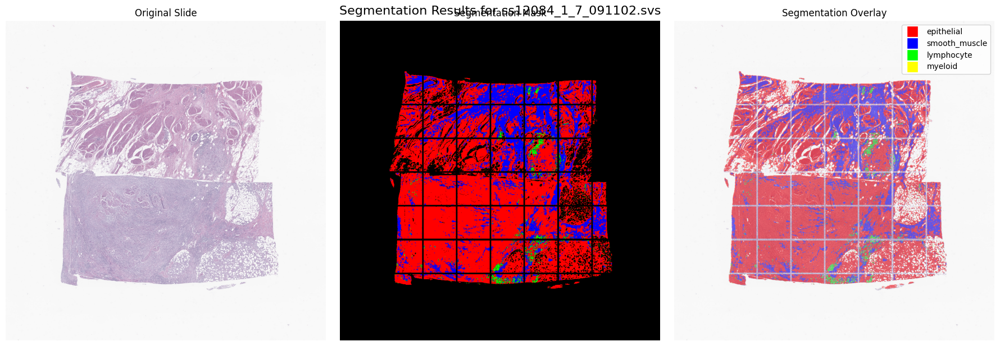

  Segmentation completed for ss12084_1_7_091102.svs

Processing ss12084_1_8_091206.svs...
Detecting tissue regions...


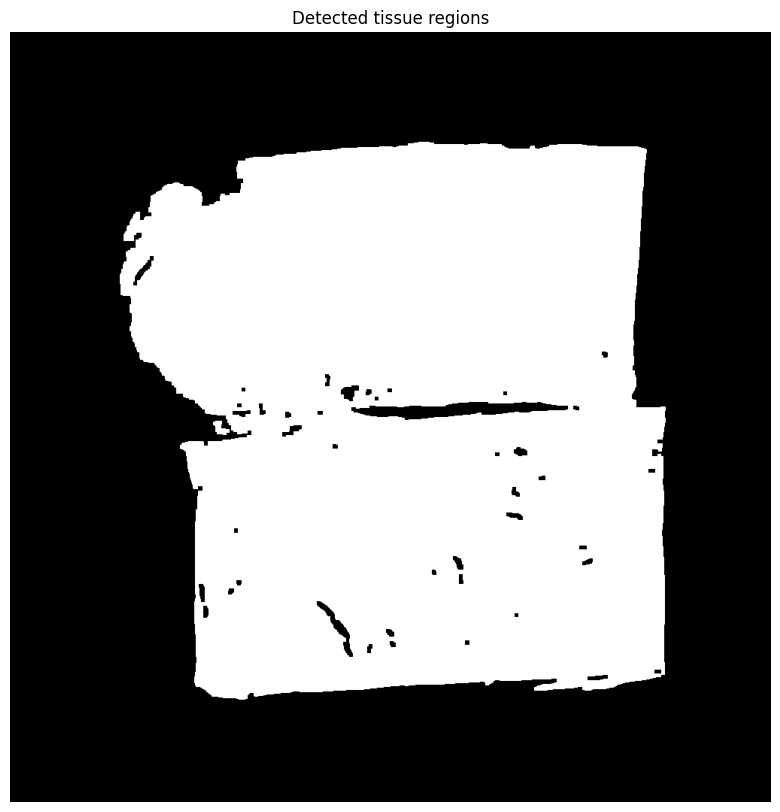

Detected 2 tissue regions
Processing region 1/2 of size 1118x977
  Processing tile at (13731, 26594) with 4 patches...


100%|██████████| 4/4 [00:15<00:00,  3.94s/it]


Processing region 2/2 of size 36922x38168
  Processing tile at (7425, 7510) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.02it/s]


  Processing tile at (12425, 7510) with 196 patches...


100%|██████████| 196/196 [01:01<00:00,  3.17it/s]


  Processing tile at (17425, 7510) with 196 patches...


100%|██████████| 196/196 [01:00<00:00,  3.25it/s]


  Processing tile at (22425, 7510) with 196 patches...


100%|██████████| 196/196 [01:15<00:00,  2.60it/s]


  Processing tile at (27425, 7510) with 196 patches...


100%|██████████| 196/196 [01:22<00:00,  2.37it/s]


  Processing tile at (32425, 7510) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  2.99it/s]


  Processing tile at (37425, 7510) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.70it/s]


  Processing tile at (42425, 7510) with 70 patches...


100%|██████████| 70/70 [00:15<00:00,  4.60it/s]


  Processing tile at (7425, 12510) with 196 patches...


100%|██████████| 196/196 [01:55<00:00,  1.69it/s]


  Processing tile at (12425, 12510) with 196 patches...


100%|██████████| 196/196 [01:10<00:00,  2.78it/s]


  Processing tile at (17425, 12510) with 196 patches...


100%|██████████| 196/196 [01:10<00:00,  2.79it/s]


  Processing tile at (22425, 12510) with 196 patches...


100%|██████████| 196/196 [01:25<00:00,  2.29it/s]


  Processing tile at (27425, 12510) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.69it/s]


  Processing tile at (32425, 12510) with 196 patches...


100%|██████████| 196/196 [01:20<00:00,  2.44it/s]


  Processing tile at (37425, 12510) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.89it/s]


  Processing tile at (42425, 12510) with 70 patches...


100%|██████████| 70/70 [00:12<00:00,  5.63it/s]


  Processing tile at (7425, 17510) with 196 patches...


100%|██████████| 196/196 [01:44<00:00,  1.87it/s]


  Processing tile at (12425, 17510) with 196 patches...


100%|██████████| 196/196 [01:44<00:00,  1.87it/s]


  Processing tile at (17425, 17510) with 196 patches...


100%|██████████| 196/196 [01:18<00:00,  2.48it/s]


  Processing tile at (22425, 17510) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.69it/s]


  Processing tile at (27425, 17510) with 196 patches...


100%|██████████| 196/196 [01:37<00:00,  2.00it/s]


  Processing tile at (32425, 17510) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.41it/s]


  Processing tile at (37425, 17510) with 196 patches...


100%|██████████| 196/196 [01:25<00:00,  2.30it/s]


  Processing tile at (42425, 17510) with 70 patches...


100%|██████████| 70/70 [00:07<00:00,  9.90it/s]


  Processing tile at (7425, 22510) with 196 patches...


100%|██████████| 196/196 [00:50<00:00,  3.87it/s]


  Processing tile at (12425, 22510) with 196 patches...


100%|██████████| 196/196 [01:14<00:00,  2.64it/s]


  Processing tile at (17425, 22510) with 196 patches...


100%|██████████| 196/196 [00:59<00:00,  3.32it/s]


  Processing tile at (22425, 22510) with 196 patches...


100%|██████████| 196/196 [00:47<00:00,  4.10it/s]


  Processing tile at (27425, 22510) with 196 patches...


100%|██████████| 196/196 [00:39<00:00,  4.91it/s]


  Processing tile at (32425, 22510) with 196 patches...


100%|██████████| 196/196 [01:07<00:00,  2.91it/s]


  Processing tile at (37425, 22510) with 196 patches...


100%|██████████| 196/196 [01:18<00:00,  2.49it/s]


  Processing tile at (42425, 22510) with 70 patches...


100%|██████████| 70/70 [00:15<00:00,  4.60it/s]


  Processing tile at (7425, 27510) with 196 patches...


100%|██████████| 196/196 [00:46<00:00,  4.17it/s]


  Processing tile at (12425, 27510) with 196 patches...


100%|██████████| 196/196 [01:08<00:00,  2.86it/s]


  Processing tile at (17425, 27510) with 196 patches...


100%|██████████| 196/196 [01:11<00:00,  2.72it/s]


  Processing tile at (22425, 27510) with 196 patches...


100%|██████████| 196/196 [01:02<00:00,  3.14it/s]


  Processing tile at (27425, 27510) with 196 patches...


100%|██████████| 196/196 [00:59<00:00,  3.28it/s]


  Processing tile at (32425, 27510) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.71it/s]


  Processing tile at (37425, 27510) with 196 patches...


100%|██████████| 196/196 [01:23<00:00,  2.34it/s]


  Processing tile at (42425, 27510) with 70 patches...


100%|██████████| 70/70 [00:22<00:00,  3.11it/s]


  Processing tile at (7425, 32510) with 196 patches...


100%|██████████| 196/196 [00:42<00:00,  4.58it/s]


  Processing tile at (12425, 32510) with 196 patches...


100%|██████████| 196/196 [01:36<00:00,  2.03it/s]


  Processing tile at (17425, 32510) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.02it/s]


  Processing tile at (22425, 32510) with 196 patches...


100%|██████████| 196/196 [01:05<00:00,  2.97it/s]


  Processing tile at (27425, 32510) with 196 patches...


100%|██████████| 196/196 [00:55<00:00,  3.51it/s]


  Processing tile at (32425, 32510) with 196 patches...


100%|██████████| 196/196 [01:03<00:00,  3.07it/s]


  Processing tile at (37425, 32510) with 196 patches...


100%|██████████| 196/196 [00:57<00:00,  3.44it/s]


  Processing tile at (42425, 32510) with 70 patches...


100%|██████████| 70/70 [00:19<00:00,  3.62it/s]


  Processing tile at (7425, 37510) with 196 patches...


100%|██████████| 196/196 [00:46<00:00,  4.21it/s]


  Processing tile at (12425, 37510) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.05it/s]


  Processing tile at (17425, 37510) with 196 patches...


100%|██████████| 196/196 [01:17<00:00,  2.52it/s]


  Processing tile at (22425, 37510) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.69it/s]


  Processing tile at (27425, 37510) with 196 patches...


100%|██████████| 196/196 [01:03<00:00,  3.10it/s]


  Processing tile at (32425, 37510) with 196 patches...


100%|██████████| 196/196 [01:28<00:00,  2.21it/s]


  Processing tile at (37425, 37510) with 196 patches...


100%|██████████| 196/196 [01:18<00:00,  2.51it/s]


  Processing tile at (42425, 37510) with 70 patches...


100%|██████████| 70/70 [00:28<00:00,  2.43it/s]


  Processing tile at (7425, 42510) with 112 patches...


100%|██████████| 112/112 [00:29<00:00,  3.76it/s]


  Processing tile at (12425, 42510) with 112 patches...


100%|██████████| 112/112 [00:45<00:00,  2.46it/s]


  Processing tile at (17425, 42510) with 112 patches...


100%|██████████| 112/112 [00:41<00:00,  2.69it/s]


  Processing tile at (22425, 42510) with 112 patches...


100%|██████████| 112/112 [00:36<00:00,  3.08it/s]


  Processing tile at (27425, 42510) with 112 patches...


100%|██████████| 112/112 [00:39<00:00,  2.82it/s]


  Processing tile at (32425, 42510) with 112 patches...


100%|██████████| 112/112 [00:33<00:00,  3.30it/s]


  Processing tile at (37425, 42510) with 112 patches...


100%|██████████| 112/112 [00:38<00:00,  2.94it/s]


  Processing tile at (42425, 42510) with 40 patches...


100%|██████████| 40/40 [00:05<00:00,  6.71it/s]


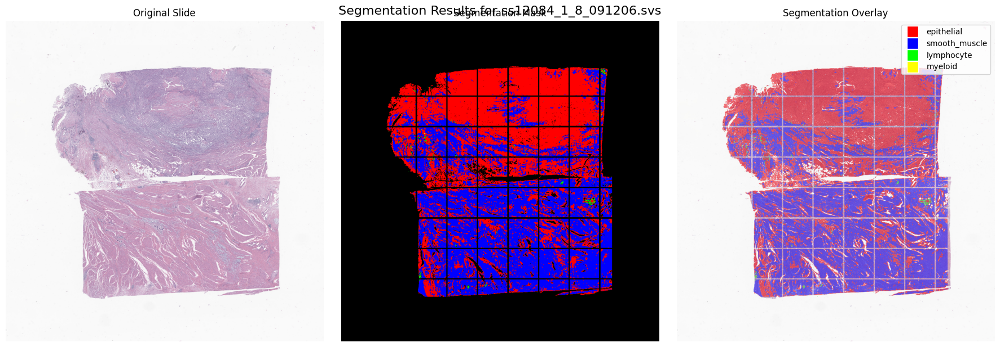

  Segmentation completed for ss12084_1_8_091206.svs

Processing ss12084_1_1_090448.svs...
Detecting tissue regions...


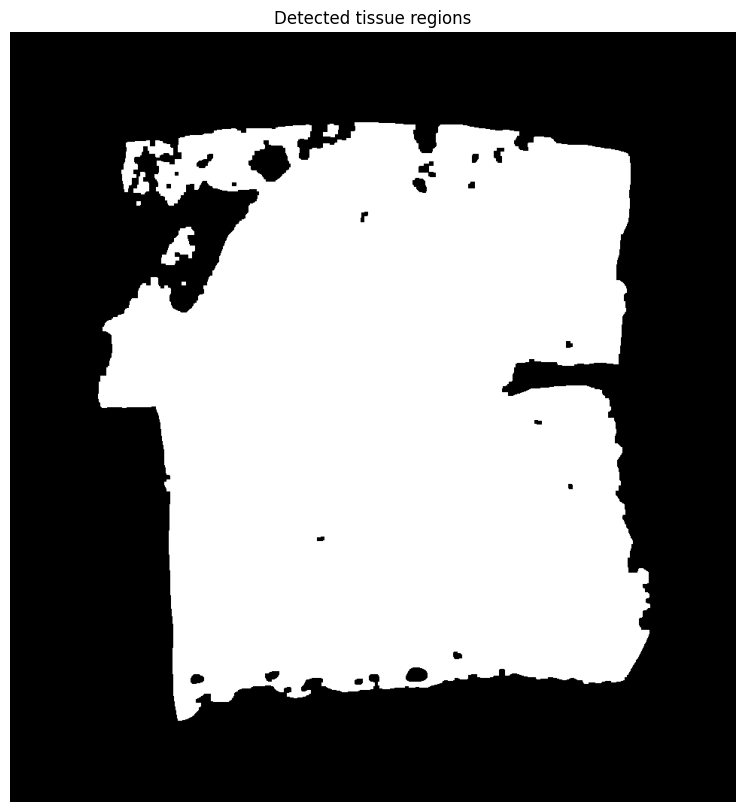

Detected 5 tissue regions
Processing region 1/5 of size 2716x3266
  Processing tile at (12132, 16587) with 63 patches...


100%|██████████| 63/63 [00:45<00:00,  1.38it/s]


Processing region 2/5 of size 1267x1921
  Processing tile at (9899, 11912) with 10 patches...


100%|██████████| 10/10 [00:34<00:00,  3.43s/it]


Processing region 3/5 of size 4164x4419
  Processing tile at (8933, 9222) with 144 patches...


100%|██████████| 144/144 [01:25<00:00,  1.68it/s]


Processing region 4/5 of size 1267x1152
  Processing tile at (25109, 7813) with 4 patches...


100%|██████████| 4/4 [00:13<00:00,  3.43s/it]


Processing region 5/5 of size 44304x50979
  Processing tile at (7062, 7685) with 196 patches...


100%|██████████| 196/196 [00:53<00:00,  3.69it/s]


  Processing tile at (12062, 7685) with 196 patches...


100%|██████████| 196/196 [01:06<00:00,  2.94it/s]


  Processing tile at (17062, 7685) with 196 patches...


100%|██████████| 196/196 [01:00<00:00,  3.24it/s]


  Processing tile at (22062, 7685) with 196 patches...


100%|██████████| 196/196 [00:50<00:00,  3.85it/s]


  Processing tile at (27062, 7685) with 196 patches...


100%|██████████| 196/196 [00:59<00:00,  3.28it/s]


  Processing tile at (32062, 7685) with 196 patches...


100%|██████████| 196/196 [00:58<00:00,  3.33it/s]


  Processing tile at (37062, 7685) with 196 patches...


100%|██████████| 196/196 [01:03<00:00,  3.07it/s]


  Processing tile at (42062, 7685) with 196 patches...


100%|██████████| 196/196 [00:56<00:00,  3.44it/s]


  Processing tile at (47062, 7685) with 168 patches...


100%|██████████| 168/168 [00:58<00:00,  2.88it/s]


  Processing tile at (7062, 12685) with 196 patches...


100%|██████████| 196/196 [00:56<00:00,  3.47it/s]


  Processing tile at (12062, 12685) with 196 patches...


100%|██████████| 196/196 [01:04<00:00,  3.05it/s]


  Processing tile at (17062, 12685) with 196 patches...


100%|██████████| 196/196 [00:52<00:00,  3.72it/s]


  Processing tile at (22062, 12685) with 196 patches...


100%|██████████| 196/196 [01:12<00:00,  2.70it/s]


  Processing tile at (27062, 12685) with 196 patches...


100%|██████████| 196/196 [01:22<00:00,  2.37it/s]


  Processing tile at (32062, 12685) with 196 patches...


100%|██████████| 196/196 [01:08<00:00,  2.85it/s]


  Processing tile at (37062, 12685) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.41it/s]


  Processing tile at (42062, 12685) with 196 patches...


100%|██████████| 196/196 [01:19<00:00,  2.45it/s]


  Processing tile at (47062, 12685) with 168 patches...


100%|██████████| 168/168 [00:55<00:00,  3.05it/s]


  Processing tile at (7062, 17685) with 196 patches...


100%|██████████| 196/196 [00:54<00:00,  3.60it/s]


  Processing tile at (12062, 17685) with 196 patches...


100%|██████████| 196/196 [00:27<00:00,  7.08it/s]


  Processing tile at (17062, 17685) with 196 patches...


100%|██████████| 196/196 [00:58<00:00,  3.36it/s]


  Processing tile at (22062, 17685) with 196 patches...


100%|██████████| 196/196 [01:02<00:00,  3.14it/s]


  Processing tile at (27062, 17685) with 196 patches...


100%|██████████| 196/196 [01:21<00:00,  2.41it/s]


  Processing tile at (32062, 17685) with 196 patches...


100%|██████████| 196/196 [01:26<00:00,  2.28it/s]


  Processing tile at (37062, 17685) with 196 patches...


 77%|███████▋  | 151/196 [01:46<00:31,  1.42it/s]
Traceback (most recent call last):
  File "<ipython-input-4-3b5529e3a8cc>", line 586, in process_all_svs_files
    segment_whole_slide(
  File "<ipython-input-4-3b5529e3a8cc>", line 349, in segment_whole_slide
    patch = slide.read_region((x, y), 0, (patch_size, patch_size))
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/__init__.py", line 281, in read_region
    region = lowlevel.read_region(
             ^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/lowlevel.py", line 443, in read_region
    _read_region(slide, buf, x, y, level, w, h)
  File "/usr/local/lib/python3.11/dist-packages/openslide/lowlevel.py", line 289, in _check_error
    raise OpenSlideError(err)
openslide.lowlevel.OpenSlideError: Cannot read raw tile


  Error processing ss12084_1_1_090448.svs: Cannot read raw tile

Processing ss12084_1_2_090548.svs...
  Error processing ss12084_1_2_090548.svs: Unsupported or missing image file

Processing ss12084_1_3_090657.svs...


Traceback (most recent call last):
  File "<ipython-input-4-3b5529e3a8cc>", line 586, in process_all_svs_files
    segment_whole_slide(
  File "<ipython-input-4-3b5529e3a8cc>", line 288, in segment_whole_slide
    slide = openslide.OpenSlide(svs_path)
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/__init__.py", line 207, in __init__
    self._osr = lowlevel.open(filename)
                ^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/lowlevel.py", line 258, in _check_open
    raise OpenSlideUnsupportedFormatError("Unsupported or missing image file")
openslide.lowlevel.OpenSlideUnsupportedFormatError: Unsupported or missing image file


  Error processing ss12084_1_3_090657.svs: Unsupported or missing image file

All slides processed. Results saved to /content/drive/MyDrive/Bladder_Segpath_Data/H&E_Svs/segmentation_results


Traceback (most recent call last):
  File "<ipython-input-4-3b5529e3a8cc>", line 586, in process_all_svs_files
    segment_whole_slide(
  File "<ipython-input-4-3b5529e3a8cc>", line 288, in segment_whole_slide
    slide = openslide.OpenSlide(svs_path)
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/__init__.py", line 207, in __init__
    self._osr = lowlevel.open(filename)
                ^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/openslide/lowlevel.py", line 258, in _check_open
    raise OpenSlideUnsupportedFormatError("Unsupported or missing image file")
openslide.lowlevel.OpenSlideUnsupportedFormatError: Unsupported or missing image file


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import openslide
from tqdm import tqdm
import torch
from torchvision import transforms
import cv2
import sys
import segmentation_models_pytorch as smp
import glob

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

FOLDER_PATH = '/content/drive/MyDrive/Bladder_Segpath_Data/H&E_Svs'  # Folder containing SVS files
CKPT_DIR = '/content/drive/MyDrive/Bladder_Segpath_Data/checkpoints'  # Folder with model checkpoints

CELL_TYPES = ['epithelial', 'smooth_muscle', 'lymphocyte', 'myeloid']

class LogCoshDiceLoss(torch.nn.Module):
    def __init__(self, smooth=1.0, eps=1e-7):
        super().__init__()
        self.smooth = smooth
        self.eps = eps

    def forward(self, y_pred, y_true):
        if y_pred.dim() == 4 and y_pred.size(1) == 1 and y_true.dim() == 3:
            # If y_pred is [B,1,H,W] and y_true is [B,H,W]
            y_true = y_true.unsqueeze(1)

        y_pred = torch.sigmoid(y_pred)

        batch_size = y_pred.size(0)
        dice_scores = []

        for i in range(batch_size):
            pred_i = y_pred[i].view(-1)
            true_i = y_true[i].float().view(-1)

            intersection = (pred_i * true_i).sum()
            dice_score = (2. * intersection + self.smooth) / (
                pred_i.sum() + true_i.sum() + self.smooth + self.eps
            )
            dice_scores.append(dice_score)

        avg_dice = torch.stack(dice_scores).mean()
        loss = torch.log(torch.cosh(1.0 - avg_dice))

        return loss

class FocalTverskyLoss(torch.nn.Module):
    def __init__(self, smooth=1, alpha=0.5, beta=0.5, gamma=1.5):
        super().__init__()
        self.smooth = smooth
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma

    def forward(self, inputs, targets):
        # Apply sigmoid to logits
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1).float()

        # Calculate Tversky index components
        TP = (inputs * targets).sum()
        FP = ((1 - targets) * inputs).sum()
        FN = (targets * (1 - inputs)).sum()

        # Calculate Tversky index
        tversky = (TP + self.smooth) / (TP + self.alpha * FP + self.beta * FN + self.smooth)

        # Apply focal component
        focal_tversky = (1 - tversky) ** self.gamma

        return focal_tversky

class BinarySegmentationModel(torch.nn.Module):
    def __init__(self,
                 architecture='deeplabv3plus',
                 encoder='efficientnet-b4',
                 lr=1e-3,
                 loss_type="ftv",
                 loss_params=None,
                 class_name=''):
        super().__init__()
        self.architecture = architecture
        self.encoder = encoder
        self.lr = lr
        self.loss_type = loss_type
        self.class_name = class_name
        self.loss_params = loss_params

        # Create the model
        self.model = self.create_model(architecture, encoder)

    def create_model(self, architecture, encoder):
        if architecture == 'deeplabv3plus':
            model = smp.DeepLabV3Plus(
                encoder_name=encoder,
                encoder_weights='imagenet',
                in_channels=3,
                classes=1,
                activation=None
            )
        elif architecture == 'unetplusplus':
            model = smp.UnetPlusPlus(
                encoder_name=encoder,
                encoder_weights='imagenet',
                in_channels=3,
                classes=1,
                activation=None
            )
        elif architecture == 'unet':
            model = smp.Unet(
                encoder_name=encoder,
                encoder_weights='imagenet',
                in_channels=3,
                classes=1,
                activation=None
            )
        else:
            raise ValueError(f"Unsupported architecture: {architecture}")
        return model

    def forward(self, x):
        return self.model(x)

    @classmethod
    def load_from_checkpoint(cls, checkpoint_path):
        # Load state dict
        checkpoint = torch.load(checkpoint_path, map_location=device)

        # Extract hyperparameters
        hparams = checkpoint.get('hyper_parameters', {})

        # Create model
        model = cls(
            architecture=hparams.get('architecture', 'deeplabv3plus'),
            encoder=hparams.get('encoder', 'efficientnet-b4'),
            loss_type=hparams.get('loss_type', 'ftv'),
            loss_params=hparams.get('loss_params', None),
            class_name=hparams.get('class_name', '')
        )

        # Load weights
        if 'state_dict' in checkpoint:
            # Remove 'model.' prefix if present
            state_dict = {}
            for k, v in checkpoint['state_dict'].items():
                if k.startswith('model.'):
                    state_dict[k[6:]] = v
                else:
                    state_dict[k] = v

            model.model.load_state_dict(state_dict, strict=False)
        else:
            model.model.load_state_dict(checkpoint, strict=False)

        return model

class EnsembleModel(torch.nn.Module):
    """Ensemble of multiple binary segmentation models
    """
    def __init__(self, models):
        super().__init__()
        self.models = torch.nn.ModuleList(models)

    def forward(self, x):
        """Forward pass through all models and average their predictions
        """
        outputs = []
        for model in self.models:
            outputs.append(model(x))
        return torch.stack(outputs).mean(dim=0)

    def predict(self, x):
        """Predict binary mask (0 or 1) from input image
        """
        with torch.no_grad():
            logits = self.forward(x)
            return (torch.sigmoid(logits) > 0.5).float()

# Function to extract a thumbnail of the entire slide
def extract_thumbnail_from_svs(svs_path, target_width=1024):
    slide = openslide.OpenSlide(svs_path)
    full_dims = slide.dimensions
    scale = target_width / full_dims[0]
    target_size = (target_width, int(full_dims[1] * scale))
    thumbnail = slide.get_thumbnail(target_size)
    thumbnail_np = np.array(thumbnail)  # Convert from PIL to NumPy array (RGB)
    return thumbnail_np, scale

# Improved simple tissue detection using RGB thumbnail (no level dependence)
def simple_tissue_detection(svs_path, target_size=(1024, 1024)):
    """
    Simple tissue detection using RGB values to distinguish tissue from background

    Args:
        svs_path: Path to SVS file
        target_size: Size to resize for detection

    Returns:
        List of regions (x, y, width, height) at full resolution
    """
    slide = openslide.OpenSlide(svs_path)
    width, height = slide.dimensions

    # Get a thumbnail at specified size
    thumb_w, thumb_h = target_size
    thumbnail = slide.get_thumbnail((thumb_w, thumb_h))
    thumb_np = np.array(thumbnail)

    # Convert to grayscale
    gray = cv2.cvtColor(thumb_np, cv2.COLOR_RGB2GRAY)

    # Apply Otsu's thresholding to separate tissue from background
    _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

    # Optional: apply morphological operations to clean up mask
    kernel = np.ones((5, 5), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

    # Find contours
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Scale factors to convert back to original dimensions
    scale_w = width / thumb_w
    scale_h = height / thumb_h

    # Convert contours to regions
    regions = []
    for contour in contours:
        # Skip small contours (likely noise)
        if cv2.contourArea(contour) < 50:  # Minimum area threshold
            continue

        # Get bounding box at the thumbnail level
        x, y, w, h = cv2.boundingRect(contour)

        # Scale to full resolution
        x0 = int(x * scale_w)
        y0 = int(y * scale_h)
        w0 = int(w * scale_w)
        h0 = int(h * scale_h)

        regions.append((x0, y0, w0, h0))

    return regions, thresh

def segment_whole_slide(svs_path, models, output_dir, thumbnail_width=1024, patch_size=640, stride=320, tile_size=5000):
    """
    Segment an entire slide using a tiling approach and tissue detection

    Args:
        svs_path: Path to SVS file
        models: Dictionary of segmentation models for each cell type
        output_dir: Directory to save results
        thumbnail_width: Width of thumbnail for visualization
        patch_size: Size of patches to extract
        stride: Stride for sliding window
        tile_size: Size of tiles to process at once
    """
    os.makedirs(output_dir, exist_ok=True)

    if not models:
        print("No models loaded, skipping segmentation")
        return None, None

    slide = openslide.OpenSlide(svs_path)
    width, height = slide.dimensions
    thumbnail, scale = extract_thumbnail_from_svs(svs_path, thumbnail_width)

    print("Detecting tissue regions...")
    regions, tissue_mask = simple_tissue_detection(svs_path)

    # detected tissue regions
    plt.figure(figsize=(10, 10))
    plt.imshow(tissue_mask, cmap='gray')
    plt.title("Detected tissue regions")
    plt.axis('off')
    plt.show()

    print(f"Detected {len(regions)} tissue regions")

    # Create empty segmentation masks for each cell type at thumbnail scale
    cell_types = list(models.keys())
    seg_masks = {cell_type: np.zeros((thumbnail.shape[0], thumbnail.shape[1]), dtype=np.float32)
                for cell_type in cell_types}

    # Define normalization transform
    normalize = transforms.Normalize(
        mean=[124.0/255, 116.0/255, 104.0/255],
        std=[58.6/255, 57.3/255, 57.6/255]
    )

    # Process each tissue region in tiles
    for region_idx, (x0, y0, w0, h0) in enumerate(regions):
        print(f"Processing region {region_idx+1}/{len(regions)} of size {w0}x{h0}")

        # Process region in tiles to avoid memory issues
        for start_y in range(y0, y0 + h0, tile_size):
            for start_x in range(x0, x0 + w0, tile_size):
                # Define coordinates for this tile
                end_x = min(start_x + tile_size, x0 + w0, width)
                end_y = min(start_y + tile_size, y0 + h0, height)

                # Skip if tile dimensions are too small
                if end_x - start_x < patch_size or end_y - start_y < patch_size:
                    continue

                # Generate patch coordinates for this tile
                coords = []
                for y in range(start_y, end_y - patch_size + 1, stride):
                    for x in range(start_x, end_x - patch_size + 1, stride):
                        coords.append((x, y))

                if not coords:
                    continue

                print(f"  Processing tile at ({start_x}, {start_y}) with {len(coords)} patches...")

                # Process patches in this tile
                for x, y in tqdm(coords):
                    # Extract patch
                    patch = slide.read_region((x, y), 0, (patch_size, patch_size))
                    patch = np.array(patch.convert('RGB'))

                    # Skip patches that are mostly white (background)
                    # Simple check: if mean pixel value is above threshold
                    if np.mean(patch) > 240:
                        continue

                    # Convert patch to tensor
                    patch_tensor = torch.tensor(patch.transpose(2, 0, 1)).float() / 255.0
                    patch_tensor = normalize(patch_tensor).unsqueeze(0).to(device)

                    # Get predictions for each cell type
                    for cell_type, model in models.items():
                        with torch.no_grad():
                            output = model(patch_tensor)
                            pred = (torch.sigmoid(output) > 0.5).float()

                            # Convert prediction to numpy
                            pred_np = pred[0].cpu().numpy()
                            if pred_np.ndim == 3 and pred_np.shape[0] == 1:
                                pred_np = pred_np.squeeze(0)

                            # Scale and position in thumbnail
                            thumbnail_x = int(x * scale)
                            thumbnail_y = int(y * scale)
                            thumbnail_patch_size = int(patch_size * scale)

                            # Resize prediction to match thumbnail scale
                            pred_resized = cv2.resize(
                                pred_np,
                                (thumbnail_patch_size, thumbnail_patch_size),
                                interpolation=cv2.INTER_LINEAR
                            )

                            # Ensure we don't go out of bounds
                            h, w = pred_resized.shape
                            end_y_mask = min(thumbnail_y + h, seg_masks[cell_type].shape[0])
                            end_x_mask = min(thumbnail_x + w, seg_masks[cell_type].shape[1])
                            h = end_y_mask - thumbnail_y
                            w = end_x_mask - thumbnail_x

                            if h > 0 and w > 0:
                                # Use maximum value for overlapping regions
                                seg_masks[cell_type][thumbnail_y:end_y_mask, thumbnail_x:end_x_mask] = np.maximum(
                                    seg_masks[cell_type][thumbnail_y:end_y_mask, thumbnail_x:end_x_mask],
                                    pred_resized[:h, :w]
                                )

                # Clear GPU memory after each tile
                torch.cuda.empty_cache()

    # Create color-coded combined segmentation
    colors = {
        'epithelial': [1, 0, 0], # Red
        'smooth_muscle': [0, 0, 1], #Blue
        'lymphocyte': [0, 1, 0], #Green
        'myeloid': [1, 1, 0] #Yellow
    }

    # Initialize combined segmentation with background
    combined_seg = np.zeros((thumbnail.shape[0], thumbnail.shape[1], len(cell_types) + 1), dtype=np.float32)
    combined_seg[:, :, 0] = 1.0  # Initialize background

    # Add each cell type
    for i, cell_type in enumerate(cell_types):
        combined_seg[:, :, i+1] = seg_masks[cell_type]
        # Update background (subtract from background)
        combined_seg[:, :, 0] = np.maximum(0, combined_seg[:, :, 0] - seg_masks[cell_type])

    # class with highest probability for each pixel
    class_indices = np.argmax(combined_seg, axis=2)

    # Create color overlay
    color_overlay = np.zeros((thumbnail.shape[0], thumbnail.shape[1], 4), dtype=np.float32)

    # Background is transparent
    color_overlay[:, :, 3] = 0.0

    # Add each cell type with alpha
    for i, cell_type in enumerate(cell_types):
        mask = (class_indices == i+1)
        if cell_type in colors:
            for c in range(3):
                color_overlay[:, :, c][mask] = colors[cell_type][c]
            color_overlay[:, :, 3][mask] = 0.5  # 50% opacity

    # Create combined image with overlay
    combined_img = thumbnail.copy().astype(np.float32) / 255.0

    # Apply overlay
    alpha = color_overlay[:, :, 3:4]
    combined_img = combined_img * (1 - alpha) + color_overlay[:, :, :3] * alpha
    combined_img = np.clip(combined_img, 0, 1)

    # Convert to 8-bit for display
    combined_img = (combined_img * 255).astype(np.uint8)

    # Create figure for visualization
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display original thumbnail
    axes[0].imshow(thumbnail)
    axes[0].set_title("Original Slide")
    axes[0].axis('off')

    # color overlay
    overlay_img = np.zeros_like(thumbnail, dtype=np.float32)
    for i, cell_type in enumerate(cell_types):
        if cell_type in colors:
            mask = (class_indices == i+1)
            for c in range(3):
                overlay_img[:, :, c][mask] = colors[cell_type][c] * 255

    axes[1].imshow(overlay_img.astype(np.uint8))
    axes[1].set_title("Segmentation Mask")
    axes[1].axis('off')

    # combined image
    axes[2].imshow(combined_img)
    axes[2].set_title("Segmentation Overlay")
    axes[2].axis('off')

    # legend
    legend_elements = []
    for cell_type in cell_types:
        if cell_type in colors:
            color = colors[cell_type]
            legend_elements.append(plt.Line2D([0], [0], marker='s', color='w',
                                  markerfacecolor=color, markersize=15,
                                  label=cell_type))

    axes[2].legend(handles=legend_elements, loc='upper right')

    plt.tight_layout()
    plt.suptitle(f"Segmentation Results for {os.path.basename(svs_path)}",
                y=1.02, fontsize=16)

    fig.savefig(os.path.join(output_dir, f"{os.path.splitext(os.path.basename(svs_path))[0]}_segmentation.png"))

    # Save individual masks and combined overlay
    for cell_type in cell_types:
        plt.imsave(
            os.path.join(output_dir, f"{os.path.splitext(os.path.basename(svs_path))[0]}_{cell_type}_mask.png"),
            seg_masks[cell_type],
            cmap='gray'
        )

    plt.imsave(
        os.path.join(output_dir, f"{os.path.splitext(os.path.basename(svs_path))[0]}_overlay.png"),
        combined_img
    )

    plt.show()
    plt.close(fig)
    slide.close()

    return combined_img, seg_masks

def process_all_svs_files(folder_path, ckpt_dir, tile_size=5000):
    """Process all SVS files in a folder"""
    # Load models for each cell type
    models = {}

    # Load models from cell type directories
    for cell_type in CELL_TYPES:
        print(f"Loading model for {cell_type}...")

        # Check if directory exists
        cell_type_dir = os.path.join(ckpt_dir, cell_type)
        if os.path.exists(cell_type_dir) and os.path.isdir(cell_type_dir):
            # Look for checkpoint files directly in the cell type directory
            ckpt_files = glob.glob(os.path.join(cell_type_dir, f'best-{cell_type}*.ckpt'))
            if ckpt_files:
                # Find the best checkpoint based on validation dice score
                best_ckpt = None
                best_dice = -1

                for ckpt_file in ckpt_files:
                    try:
                        # Try to extract validation dice from filename
                        if 'val_dice=' in ckpt_file:
                            parts = ckpt_file.split('val_dice=')
                            score_part = parts[1].split('-')[0].split('.ckpt')[0]
                            val_dice = float(score_part)

                            if val_dice > best_dice:
                                best_dice = val_dice
                                best_ckpt = ckpt_file
                        else:
                            # If no val_dice in filename, just use the first one
                            if best_ckpt is None:
                                best_ckpt = ckpt_file
                    except:
                        continue

                if best_ckpt:
                    try:
                        model = BinarySegmentationModel.load_from_checkpoint(best_ckpt)
                        model.eval()
                        model.to(device)
                        models[cell_type] = model
                        print(f"  Loaded model from {os.path.basename(best_ckpt)}")
                        continue
                    except Exception as e:
                        print(f"  Error loading model from {best_ckpt}: {e}")

            print(f"  No suitable model found for {cell_type}")
        else:
            print(f"  Directory for {cell_type} not found")

    # Create output directory
    output_dir = os.path.join(folder_path, 'segmentation_results')
    os.makedirs(output_dir, exist_ok=True)

    # Process each SVS file
    svs_files = [f for f in os.listdir(folder_path) if f.endswith('.svs')]

    if not svs_files:
        print(f"No SVS files found in {folder_path}")
        return

    print(f"Found {len(svs_files)} SVS files to process")

    for svs_file in svs_files:
        svs_path = os.path.join(folder_path, svs_file)
        print(f"\nProcessing {svs_file}...")

        try:
            # Segment whole slide
            segment_whole_slide(
                svs_path=svs_path,
                models=models,
                output_dir=output_dir,
                tile_size=tile_size
            )
            print(f"  Segmentation completed for {svs_file}")
        except Exception as e:
            print(f"  Error processing {svs_file}: {e}")
            import traceback
            traceback.print_exc()

    print(f"\nAll slides processed. Results saved to {output_dir}")

# Display setting for matplotlib
%matplotlib inline
plt.rcParams['figure.figsize'] = [15, 10]

# Call the function to process all SVS files I am also using tile_size to control memory usage
process_all_svs_files(FOLDER_PATH, CKPT_DIR, tile_size=5000)

# Conclusion

This notebook completed:
- Training binary segmentation models for each bladder cell type
- Building ensemble models
- Evaluating performance with Dice, Precision, Recall, and F1-score
- Visualizing predictions and combined segmentations
